In [2]:
%matplotlib notebook

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib

import time
import pickle

import memory_profiler

%load_ext memory_profiler

from pathlib import Path

In [9]:
import black
import jupyter_black

jupyter_black.load(line_length=79)

In [3]:
%load_ext autoreload
%autoreload 2

import pubmed_landscape_src
from pubmed_landscape_src.plotting import plot_tsne_genders
from pubmed_landscape_src.exploration import (
    find_mask_words,
    print_tfidf_top_words,
    print_tfidf_threshold_words,
    print_numbers_names,
    print_numbers_names_label,
)

In [4]:
variables_path = Path("../results/variables")
figures_path = Path("../results/figures")
berenslab_data_path = Path("/gpfs01/berens/data/data/pubmed_processed")

In [5]:
plt.style.use("matplotlib_style.txt")

# Import

In [13]:
# import clean_df_updated
year_name_gender_first_author_df = pd.read_pickle(
    variables_path / "year_name_gender_first_author_df"
)
year_name_gender_last_author_df = pd.read_pickle(
    variables_path / "year_name_gender_last_author_df"
)

In [14]:
tsne_reparsed = np.load(variables_path / "bert/tsne_reparsed.npy")

# Embedding colored by predicted gender

In [15]:
gender_first_author = year_name_gender_first_author_df.Gender.to_numpy()
gender_first_author

array(['unknown', 'unknown', 'unknown', ..., 'female', 'male', 'unknown'],
      dtype=object)

In [16]:
name_first_author = year_name_gender_first_author_df.Names.to_numpy()
name_first_author

array(['', '', '', ..., 'Indira', 'Giuseppe', 'Huan'], dtype=object)

In [17]:
print(
    "Number of predicted names: ",
    len(np.where(gender_first_author != "unknown")[0]),
)
print(
    "Number of female names: ",
    len(np.where(gender_first_author == "female")[0]),
)
print(
    "Number of male names: ", len(np.where(gender_first_author == "male")[0])
)

Number of predicted names:  8363116
Number of female names:  3543592
Number of male names:  4819524


## First authors

In [20]:
unknown_name_mask = (gender_first_author == "unknown") & (
    name_first_author == ""
)
unknown_gender_mask = (gender_first_author == "unknown") & (
    name_first_author != ""
)

In [21]:
colors_first_author = np.where(
    unknown_name_mask, "lightgrey", name_first_author
)

In [22]:
colors_first_author

array(['lightgrey', 'lightgrey', 'lightgrey', ..., 'Indira', 'Giuseppe',
       'Huan'], dtype=object)

In [23]:
%%time
colors_first_author = np.where(
    unknown_name_mask, "lightgrey", name_first_author
)
colors_first_author = np.where(
    unknown_gender_mask, "black", colors_first_author
)
colors_first_author = np.where(
    gender_first_author == "female", "tab:orange", colors_first_author
)
colors_first_author = np.where(
    gender_first_author == "male", "tab:blue", colors_first_author
)
colors_first_author

CPU times: user 1.76 s, sys: 74 µs, total: 1.76 s
Wall time: 1.76 s


array(['lightgrey', 'lightgrey', 'lightgrey', ..., 'tab:orange',
       'tab:blue', 'black'], dtype=object)

In [14]:
np.save(variables_path / 'colors_gender_first_author', colors_first_author)

In [33]:
colors_first_author = np.load(
    variables_path / "colors_gender_first_author.npy", allow_pickle=True
)

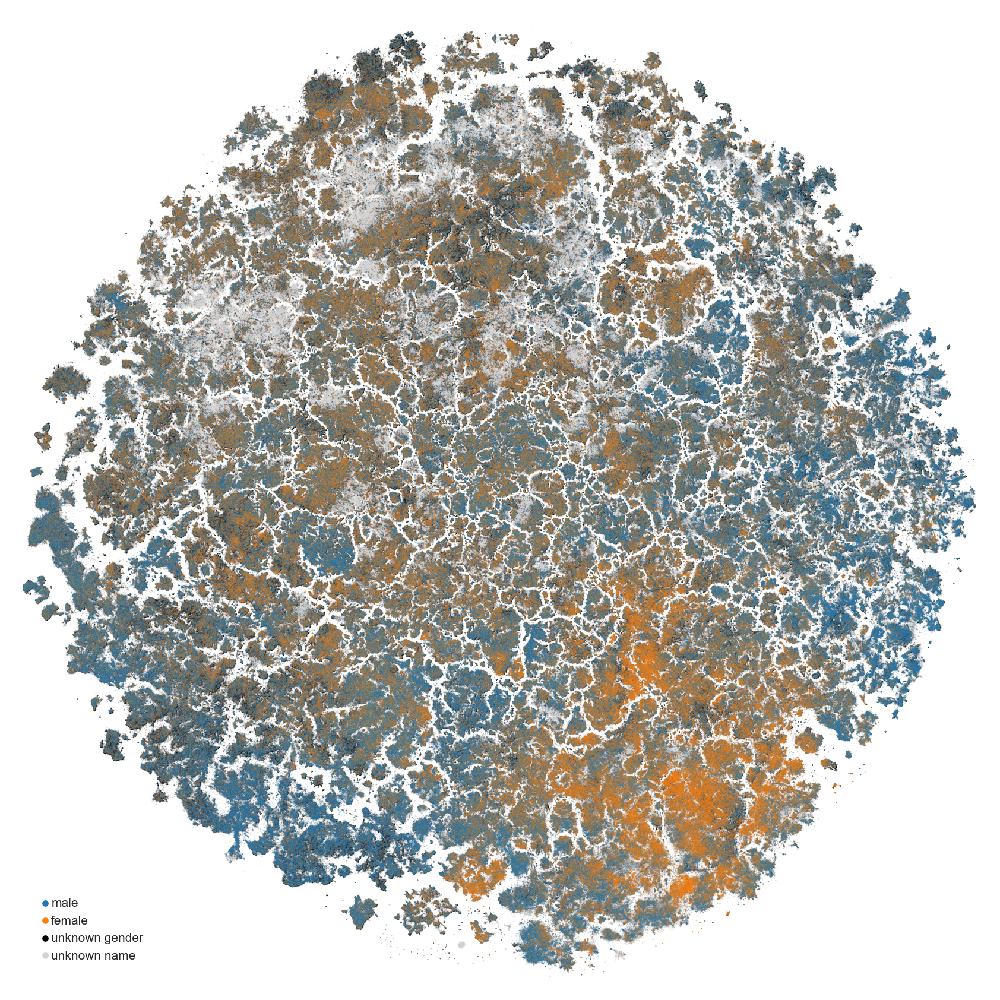

In [43]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

x_lim = (-220, 220)
y_lim = (-220, 220)
plot_tsne_genders(
    tsne, colors_first_author, x_lim=x_lim, y_lim=y_lim, ax=ax, legend=True
)

# fig.savefig(figures_path / "tsne_colored_by_gender_first_author.png")

### Embedding gender for some labels

#### Import

In [18]:
# load
# legend colors
pickle_in = open(
    variables_path / "colors_new_labels_with_more_legend.pkl", "rb"
)
colors_new_labels_with_more_legend = pickle.load(pickle_in)

colors_new_labels_with_more = np.load(
    variables_path / "colors_new_labels_with_more.npy", allow_pickle=True
)

In [19]:
# import clean_df_updated
clean_df_updated_reparsed_filtered_with_authors_ISSN = pd.read_pickle(
    berenslab_data_path
    / "clean_df_updated_reparsed_filtered_with_authors_ISSN"
)

tcmalloc: large alloc 1073741824 bytes == 0x9108ea000 @ 
tcmalloc: large alloc 1233903616 bytes == 0x9ba86a000 @ 
tcmalloc: large alloc 2147483648 bytes == 0xa04928000 @ 
tcmalloc: large alloc 1542381568 bytes == 0x9509ea000 @ 
tcmalloc: large alloc 1927979008 bytes == 0xa84928000 @ 


In [20]:
# load
tfidf_features_updated_reparsed = sp.sparse.load_npz(
    variables_path / "tfidf_features_updated_reparsed.npz"
)

tcmalloc: large alloc 18038185984 bytes == 0xa04928000 @ 
tcmalloc: large alloc 18038185984 bytes == 0xf2ba60000 @ 


In [21]:
# legend colors
pickle_in = open(variables_path / "vocabulary_updated_reparsed.pkl", "rb")
vocabulary_updated_reparsed = pickle.load(pickle_in)

In [22]:
# define vocabulary swap
vocabulary_swap = {
    value: key for key, value in vocabulary_updated_reparsed.items()
}

#### Radiology

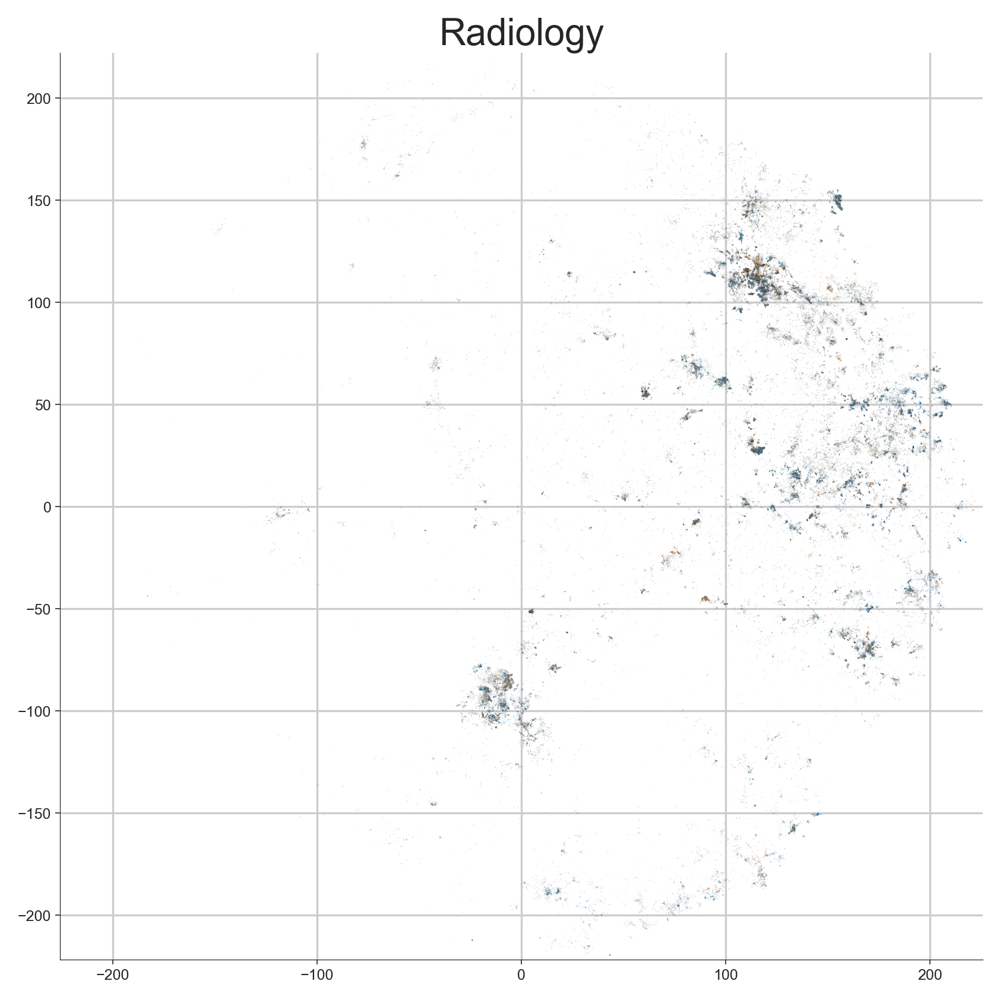

In [51]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "radiology"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (-220, 220)
y_lim = (-220, 220)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

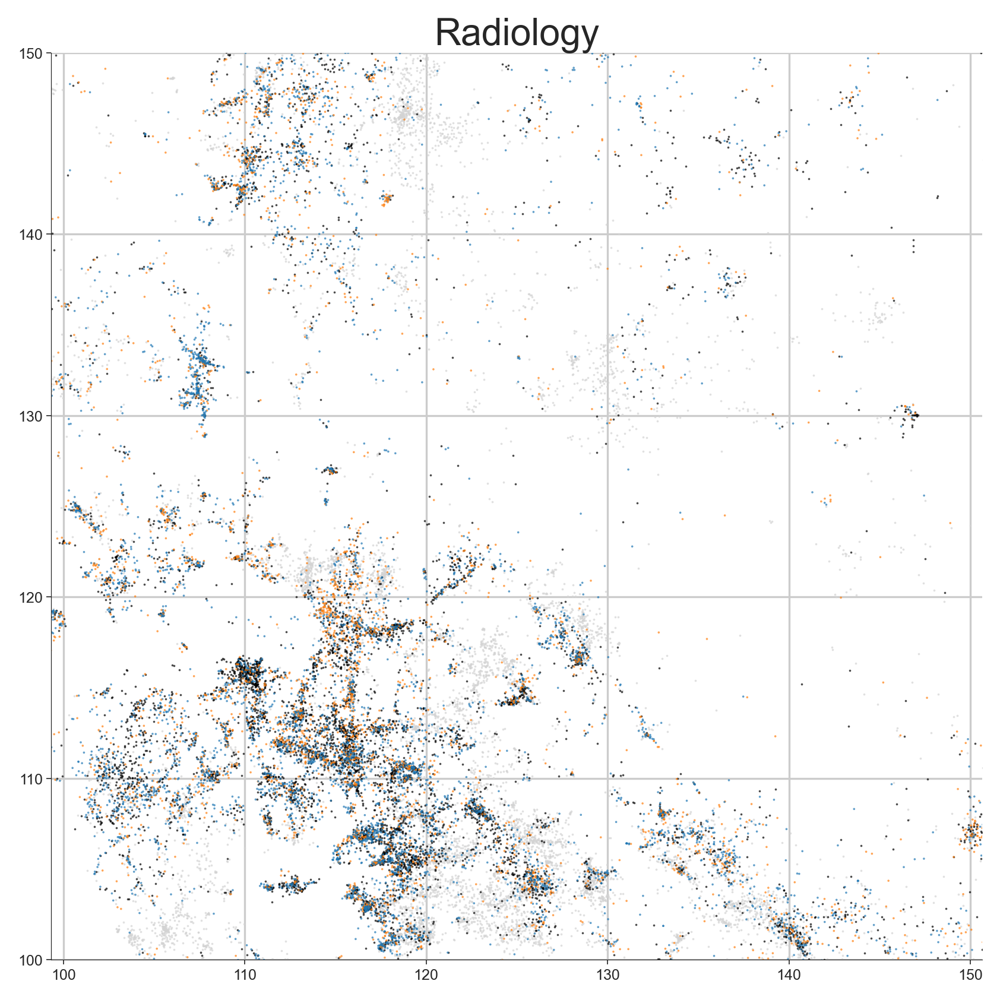

In [34]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "radiology"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (100, 150)
y_lim = (100, 150)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

In [392]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
right = 125
left = 105
top = 125
bottom = 105
mask_radiology = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [398]:
clean_df_updated_reparsed_filtered_with_authors_ISSN.Title[mask_radiology].tolist()[:10]

["Clinical Mammography. A review of the radiologist's role in disease of the breast.",
 'Clinical staging of malignant lymphoma in patients suspected to have hepato-splenic schistosomiasis.',
 "Repeat Lymphography in Non-Hodgkin's Lymphoma.",
 "The value of laparotomy and splenectomy in the management of early Hodgkin's disease. A report from the British National Lymphoma Investigation.",
 'The role of lymphography in "apparently localized" prostatic carcinoma.',
 'Iliac lymph nodes as a primary lymph center draining the testicles.',
 'Lymphography in the diagnosis of metastases from carcinoma of the uterine cervix stages i and ii.',
 "Cavography and lymphangiography in hodgkin's disease.",
 'The application of ultrasound to the study of thyroid enlargement: management of 450 cases.',
 'Ultrasound B-scans for clinical evaluation of neoplastic neck nodes.']

In [403]:
print_tfidf_top_words(tfidf_features_updated_reparsed, mask_radiology, n=10)

There are 54756 papers.
TF-IDF:  [0.04468218 0.04459863 0.04124891 0.04036462 0.03904965 0.03733128
 0.03566357 0.03564037 0.03474508 0.03358044]
Words:  ['patients' 'imaging' 'the' 'of' 'and' 'ct' 'were' 'mri' 'breast' 'tumor']


In [408]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, mask_radiology, n=10)

There are 54756 papers.
In this threshold there are 54756 papers.
For threshold = 0.10 [10986 10305 10208  9087  8768  7858  6788  6459  6378  5440]
For threshold = 0.10 ['ct' 'breast' 'mri' 'imaging' 'lesions' 'tumor' 'benign' 'pet'
 'malignant' 'tumors']


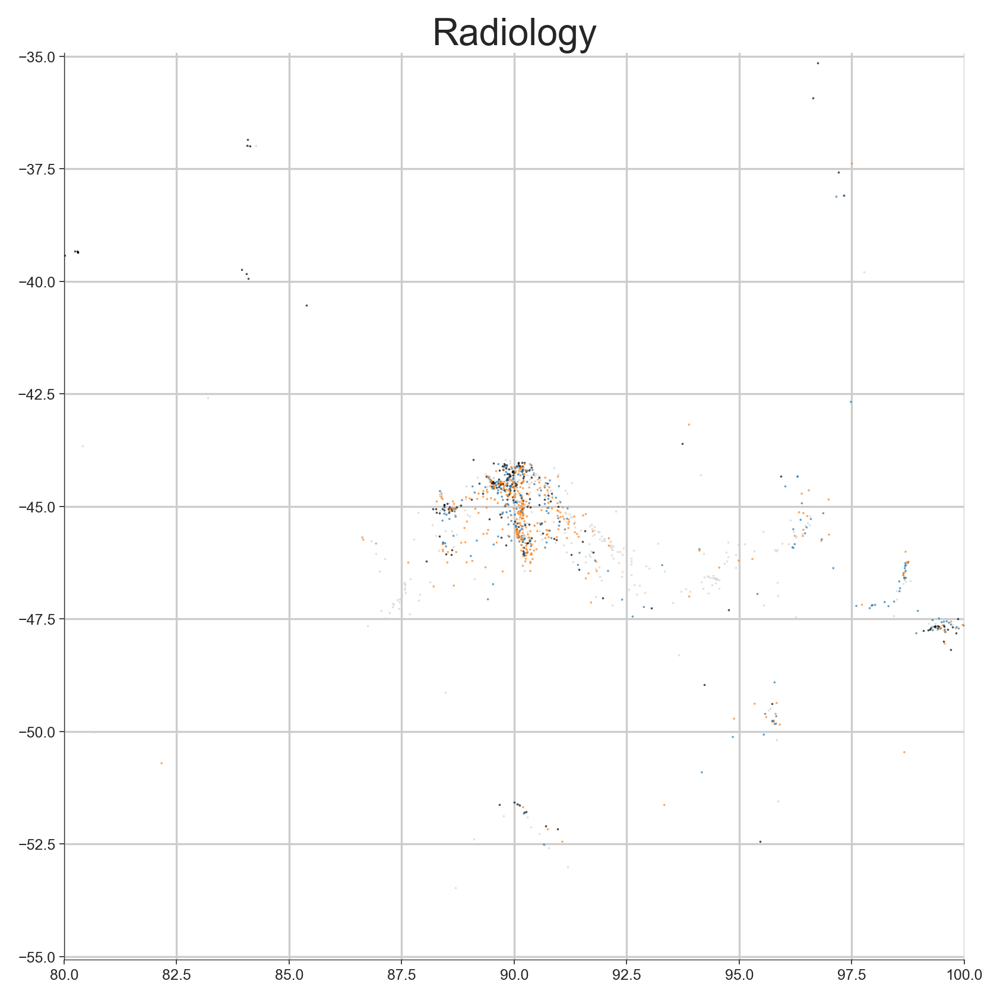

In [35]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "radiology"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (80, 100)
y_lim = (-50, -40)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

In [473]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
right = 100
left = 80
top = -40
bottom = -50
mask_radiology_female_blob = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [474]:
clean_df_updated_reparsed_filtered_with_authors_ISSN.Title[mask_radiology_female_blob].tolist()[:10]

['Mammography, xeroradiography, and thermography.',
 'Breast feeding and breast cancer.',
 'A clinical appraisal of patients following long-term contraception.',
 'Nonpuerperal breast secretion. Its relation to the use of oral contracetpives.',
 'The development of a genetic investigation centre at a maternity hospital.',
 'Breastfeeding after cesarean delivery: a systematic review and meta-analysis of world literature.',
 'Are prenatal ultrasound scans associated with the autism phenotype? Follow-up of a randomised controlled trial.',
 "Physical competition increases testosterone among Amazonian forager-horticulturalists: a test of the 'challenge hypothesis'.",
 'Laryngeal cancer and silica dust exposure: a systematic review and meta-analysis.',
 'Effects of parity and mode of delivery on urinary incontinence among postmenopausal women in Taiwan.']

In [477]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, mask_radiology_female_blob, n=20)

There are 29193 papers.
In this threshold there are 29193 papers.
For threshold = 0.10 [10519  9017  7809  7156  6714  6480  5826  4086  2853  2636  2520  2287
  2046  2040  1993  1904  1894  1827  1750  1729]
For threshold = 0.10 ['women' 'cancer' 'ci' '95' 'breast' 'risk' 'screening' 'meta' 'pregnancy'
 'mammography' 'rr' 'studies' 'prevalence' 'pooled' 'cancers' 'trials'
 'age' 'birth' 'incidence' 'mortality']


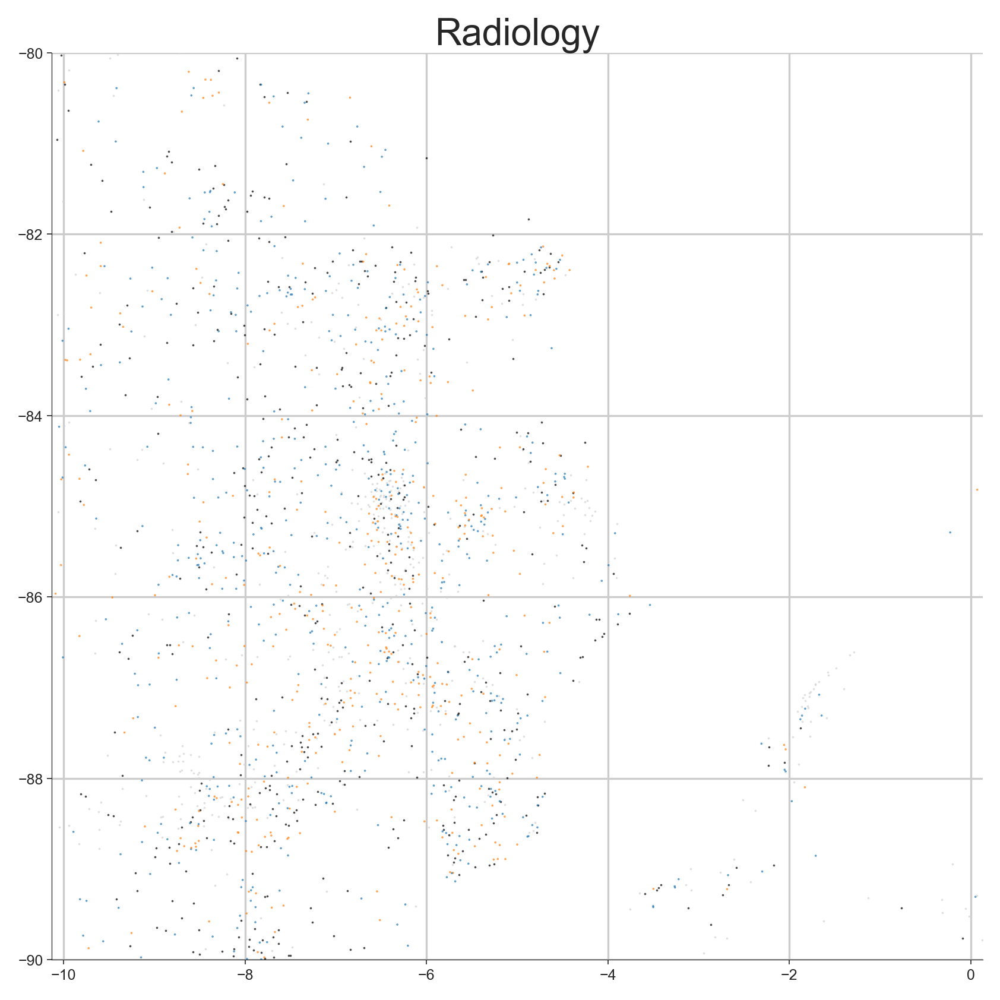

In [36]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "radiology"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (-10, 0)
y_lim = (-90, -80)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

In [490]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
right = 0
left = -10
top = -80
bottom = -90
mask_radiology_female_blob_2 = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) #& (gender_first_author == 'female')

In [491]:
clean_df_updated_reparsed_filtered_with_authors_ISSN.Title[mask_radiology_female_blob_2].tolist()[:10]

['Simultaneous irradiation of the breast and regional lymph nodes in prone position using helical tomotherapy.',
 'Robotic-based carbon ion therapy and patient positioning in 6 degrees of freedom: setup accuracy of two standard immobilization devices used in carbon ion therapy and IMRT.',
 'High-dose radiotherapy in inoperable nonsmall cell lung cancer: comparison of volumetric modulated arc therapy, dynamic IMRT and 3D conformal radiotherapy.',
 'Use of a deformable atlas to identify cryptic critical structures in the treatment of glioblastoma multiforme.',
 'Cone-beam computed tomography in hypofractionated stereotactic radiotherapy for brain metastases.',
 'Scanned carbon beam irradiation of moving films: comparison of measured and calculated response.',
 'Optimization of the open-loop liquid crystal adaptive optics retinal imaging system.',
 'Comparison between prone and supine patient setup for spine stereotactic body radiosurgery.',
 'Multileaf collimator tracking integrated with

In [492]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, mask_radiology_female_blob_2, n=20)

There are 17445 papers.
In this threshold there are 17445 papers.
For threshold = 0.10 [5497 4490 3613 3191 2866 2765 2688 2427 2407 2312 2248 2103 2084 1651
 1623 1594 1507 1467 1433 1423]
For threshold = 0.10 ['dose' 'plans' 'planning' 'gy' 'ptv' 'volume' 'imrt' 'radiotherapy'
 'plan' 'mm' 'prostate' 'ct' 'dosimetric' 'coverage' 'motion' 'vmat'
 'target' 'beam' 'radiation' 'ctv']


#### Ethics

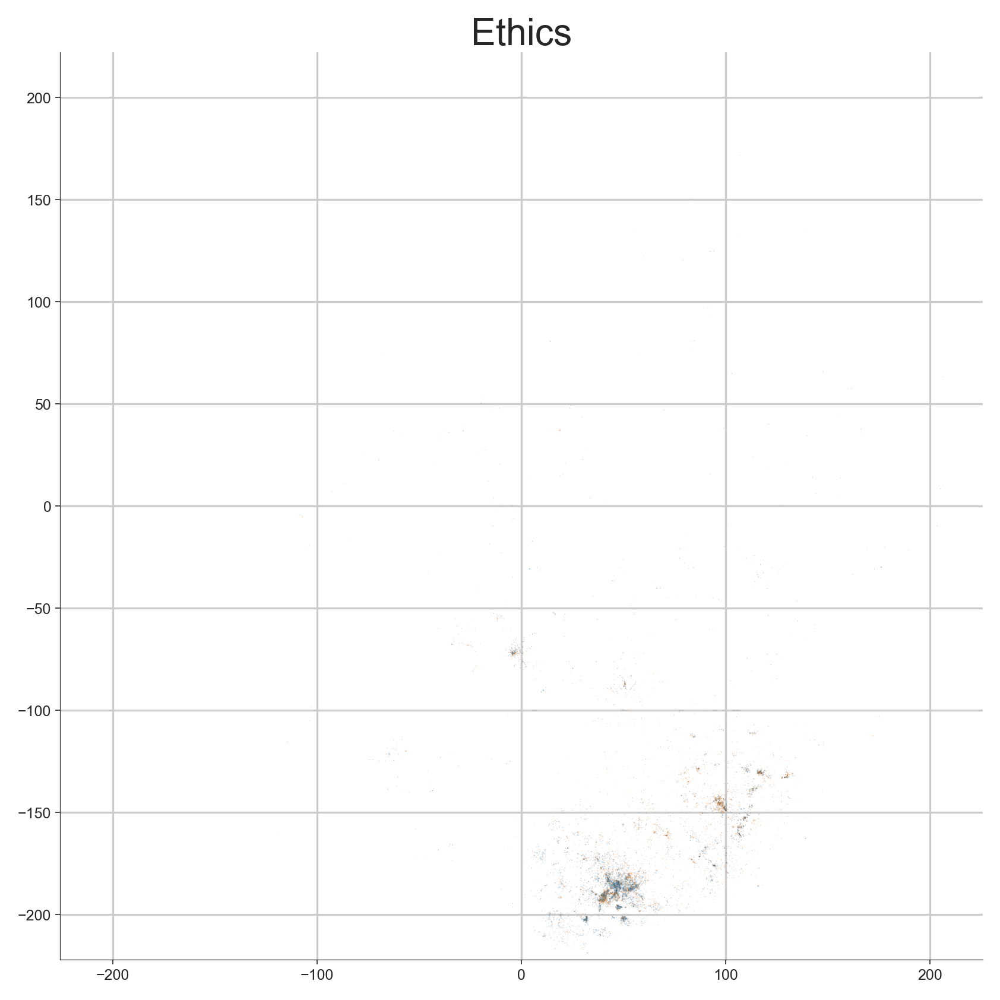

In [37]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "ethics"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (-220, 220)
y_lim = (-220, 220)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

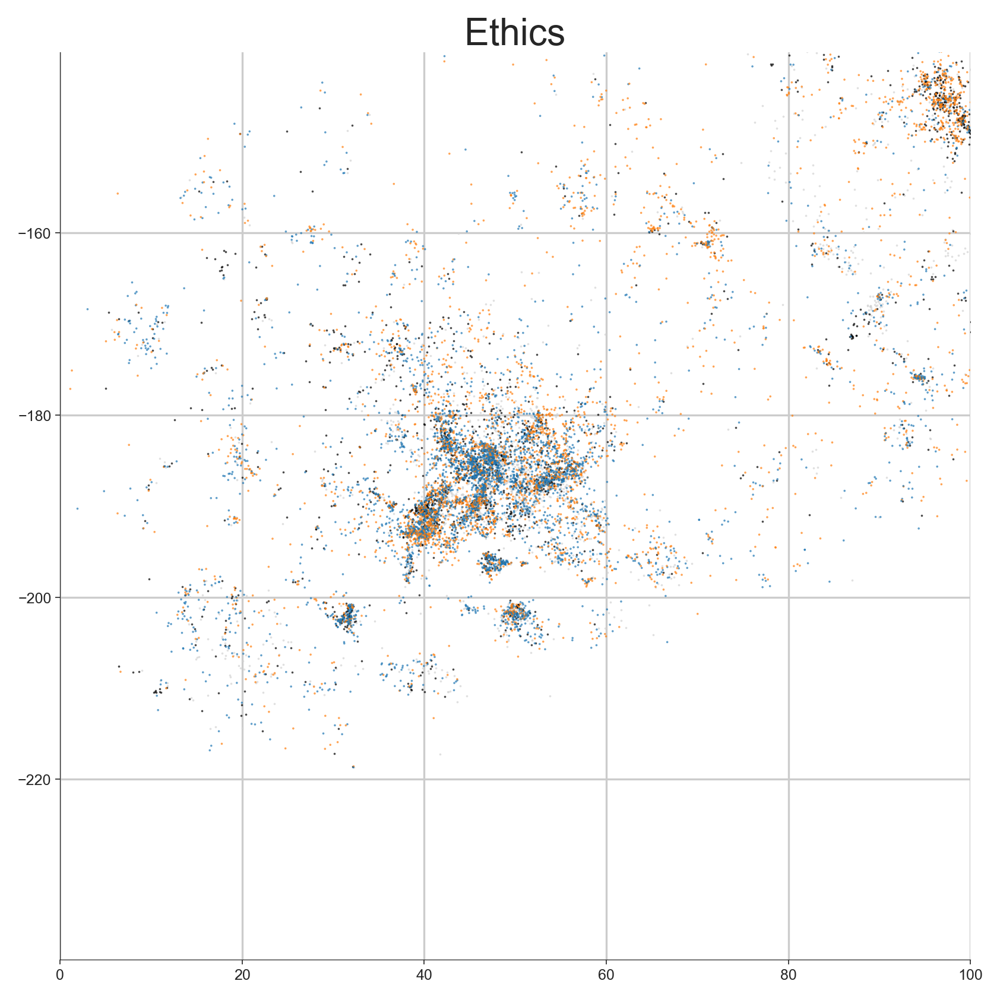

In [39]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "ethics"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (0, 100)
y_lim = (-200, -180)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

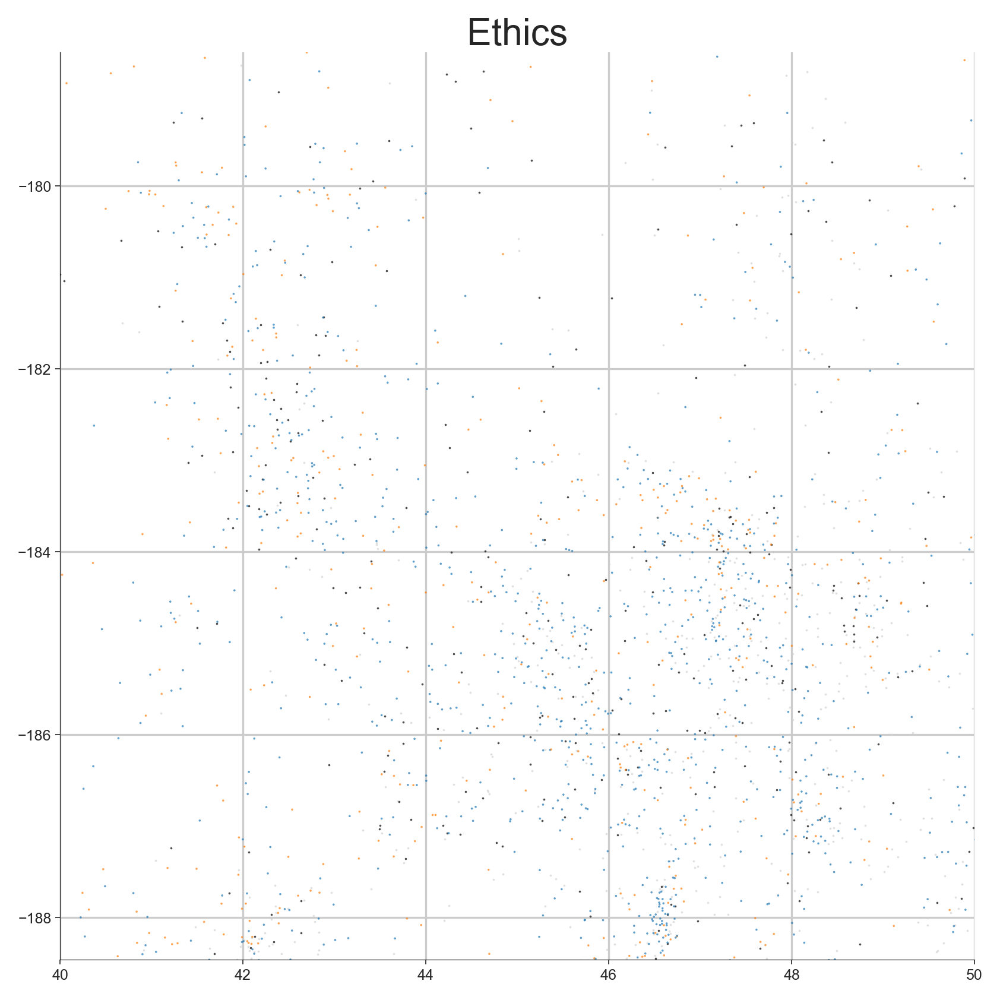

In [40]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "ethics"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (40, 50)
y_lim = (-187, -180)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

In [441]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
left = 40
right = 50
bottom = -187
top = -180
mask_ethics_more_male = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [427]:
clean_df_updated_reparsed_filtered_with_authors_ISSN.Title[mask_ethics_more_male].tolist()[:10]

['Rights and health care--beyond equity and efficiency.',
 'Quest for long-term solutions for old problems.',
 'Guidelines of the Council on Environmental Quality for the preparation of environmental impact statements.',
 'Hospital workers: class conflicts in the making.',
 'Preventing biological weapon development through the governance of life science research.',
 'Person: centre both of clinical ethics  and of public health ethics. Commentary.',
 'Research ethics committees and community values: Devlin, Dworkin, Hart and beyond.',
 'Public health ethics theory: review and path to convergence.',
 'Current research on public perceptions of nanotechnology.',
 'Antidepressants and advertising: psychopharmaceuticals in crisis.']

In [448]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, mask_ethics_more_male, n=20)#, several_th = True)

There are 10807 papers.
In this threshold there are 10807 papers.
For threshold = 0.10 [1873 1845 1656 1500 1216 1027  984  981  957  895  886  884  869  811
  700  650  626  596  595  595]
For threshold = 0.10 ['ethical' 'moral' 'ethics' 'health' 'public' 'bioethics' 'science'
 'argue' 'research' 'scientific' 'medicine' 'social' 'medical' 'policy'
 'political' 'what' 'argues' 'care' 'philosophical' 'issues']


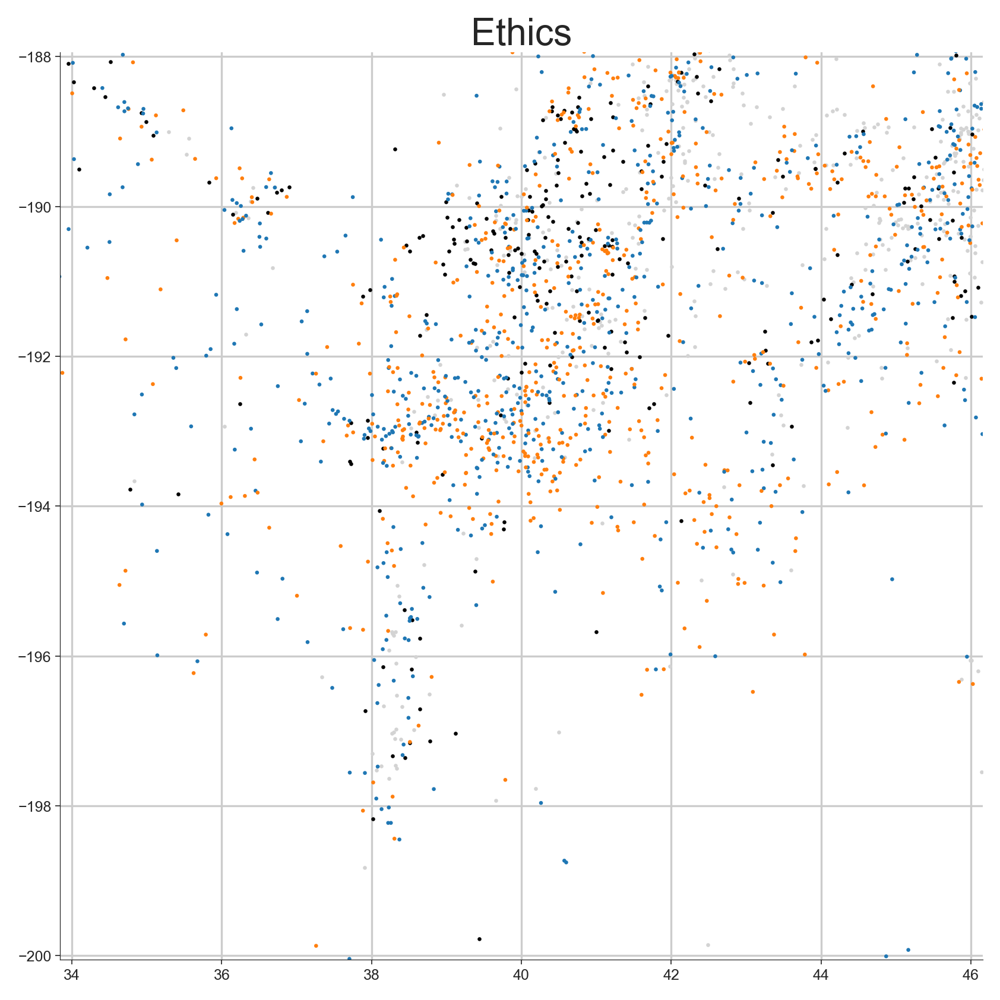

In [42]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "ethics"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (35, 45)
y_lim = (-200, -188)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="test",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

In [433]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
left = 35
right = 45
bottom = -200
top = -188
mask_ethics_more_female = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [434]:
clean_df_updated_reparsed_filtered_with_authors_ISSN.Title[mask_ethics_more_female].tolist()[:10]

['Ethical considerations in human experimentation.',
 'Editorial: The right to know.  On the freedom of medical information.',
 'Oscillococcinum for influenza treatment.',
 'Conflicts among multinational ethical and scientific standards for clinical trials of therapeutic interventions.',
 "The roles and responsibilities of physicians in patients' decisions about unproven stem cell therapies.",
 'Successful implementation of cognitive interviews in special populations.',
 'Magic bullets in cardiac anesthesia and intensive care.',
 'Points to consider in assessing and appraising predictive genetic tests.',
 'Getting a head start: the importance of personal genetics education in high schools.',
 'Health law in the 21st century.']

In [449]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, mask_ethics_more_female, n=20)

There are 16027 papers.
In this threshold there are 16027 papers.
For threshold = 0.10 [5089 4254 2408 2248 2046 1873 1819 1625 1535 1436 1251 1221 1157 1128
 1111 1098 1036 1033  974  960]
For threshold = 0.10 ['research' 'ethical' 'trials' 'consent' 'genetic' 'ethics' 'issues'
 'clinical' 'informed' 'legal' 'trial' 'scientific' 'medicine'
 'researchers' 'practice' 'testing' 'health' 'public' 'medical'
 'information']


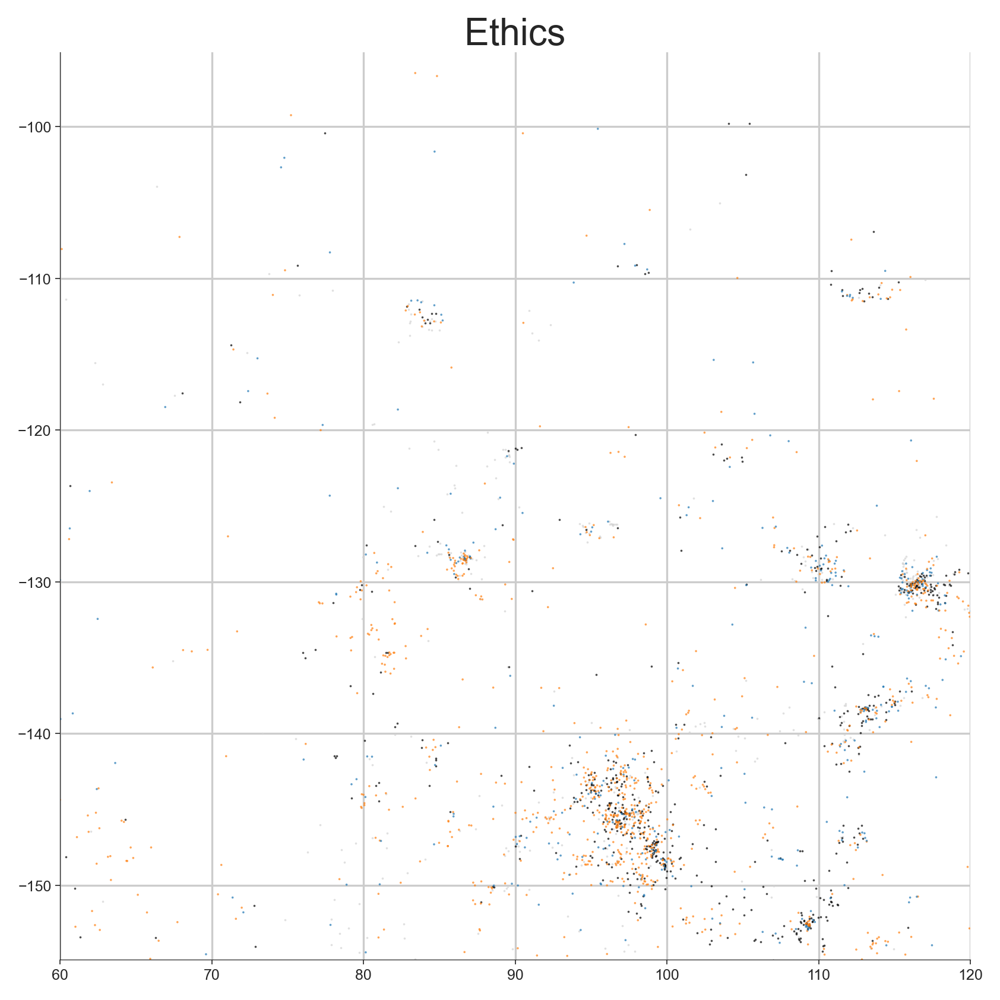

In [43]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "ethics"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (60, 120)
y_lim = (-150, -100)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

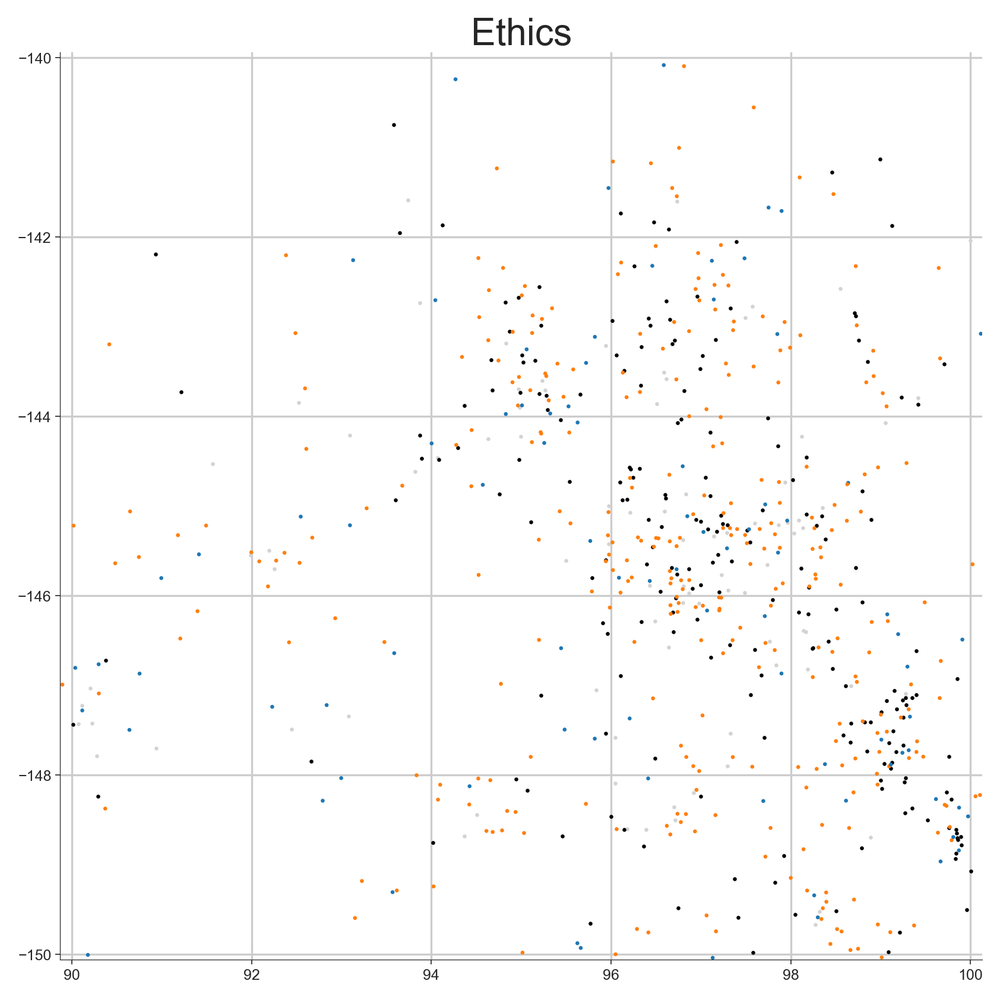

In [45]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "ethics"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (90, 100)
y_lim = (-150, -140)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="test",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

In [438]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
left = 90
right = 100
bottom = -150
top = -140
mask_ethics_female_blob = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [439]:
clean_df_updated_reparsed_filtered_with_authors_ISSN.Title[mask_ethics_female_blob].tolist()[:10]

['A measurement of attitudes about an activity program.',
 "Quality of life and burden in caregivers for patients with Parkinson's disease: concepts, assessment and related factors.",
 'The ceremonial order of public health nursing consultations: an ethnographic study.',
 "Health care professionals' perspectives on oral care for long-term care residents: nursing staff, speech-language pathologists and dental hygienists.",
 'The factors affecting end-of-life decision-making by physicians of patients with intellectual disabilities in the Netherlands: a qualitative study.',
 'Successful management of disruptive behavior: a descriptive study.',
 'Helping self-mutilating adolescents: descriptions of Finnish nurses.',
 'Shared care: the barriers encountered by community-based palliative care teams in Ontario, Canada.',
 '"Stop the noise!" From voice to silence.',
 'Developing and testing a strategy to enhance a palliative approach and care continuity for people who have dementia: study overv

In [450]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, mask_ethics_female_blob, n=10)

There are 18119 papers.
In this threshold there are 18119 papers.
For threshold = 0.10 [7837 5383 3589 2651 2443 2163 2000 1965 1954 1870]
For threshold = 0.10 ['care' 'nurses' 'nursing' 'interviews' 'experiences' 'palliative' 'life'
 'themes' 'people' 'staff']


#### Education

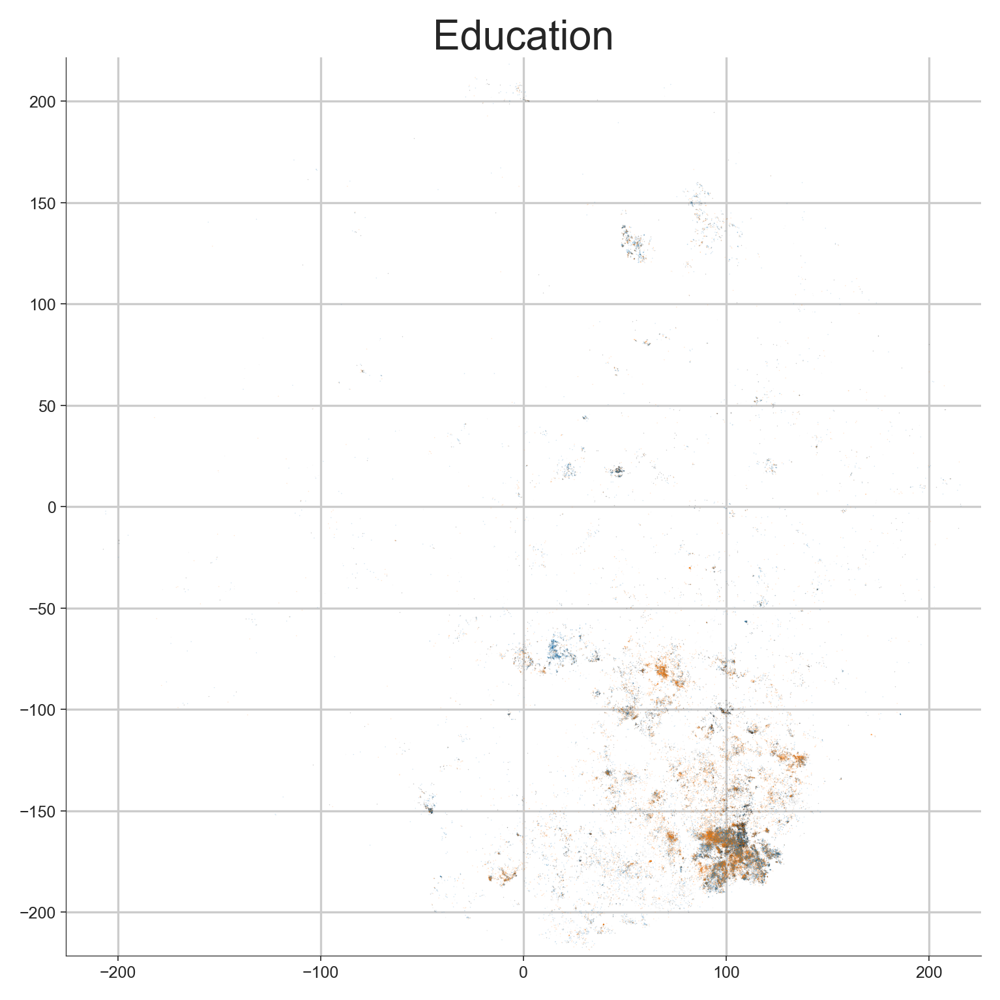

In [47]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5, 5), dpi=300, layout="constrained")

label = "education"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (-220, 220)
y_lim = (-220, 220)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

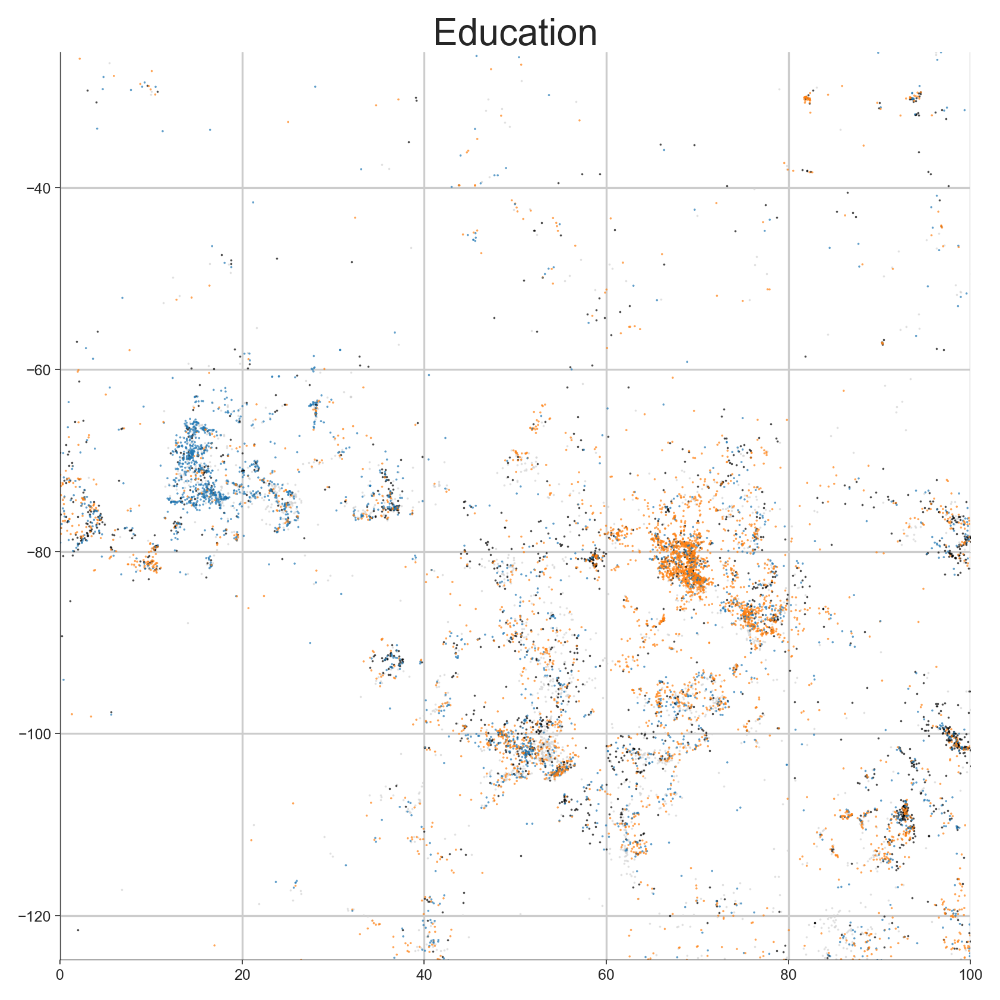

In [48]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "education"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (0, 100)
y_lim = (-100, -50)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

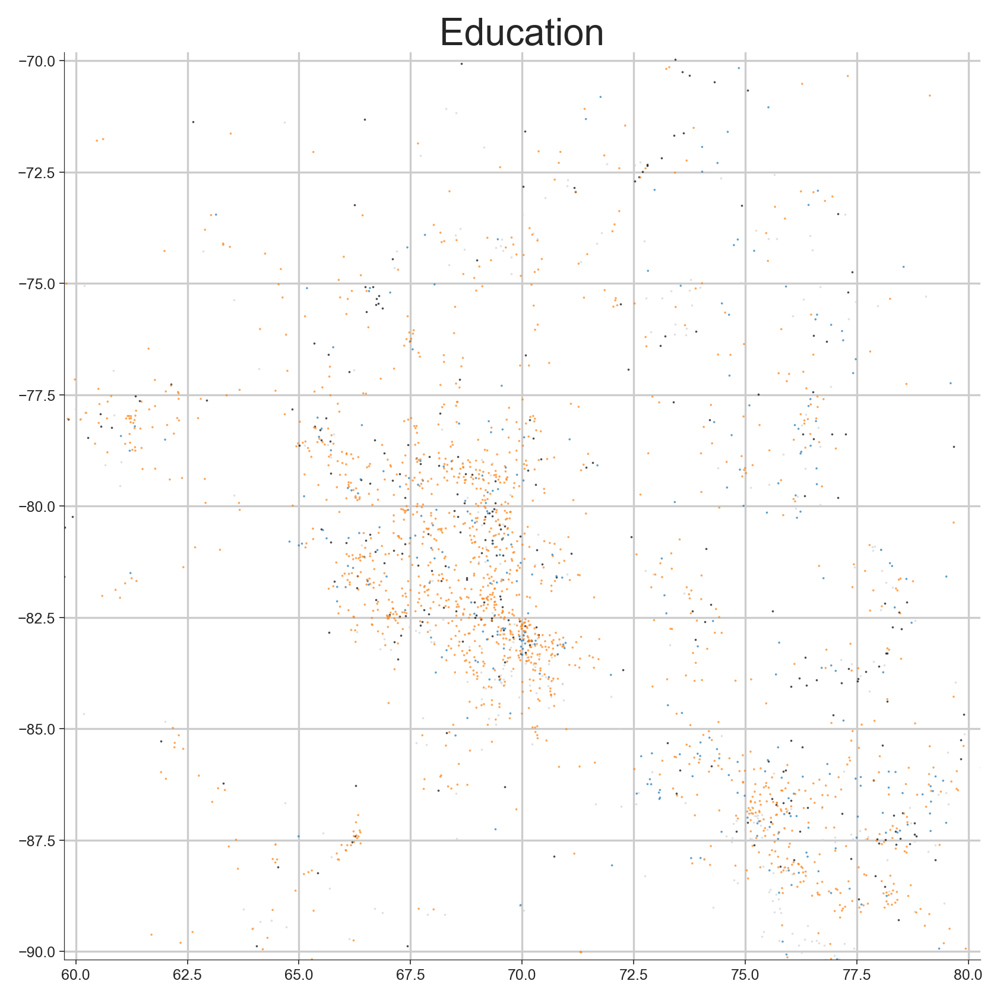

In [49]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "education"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (60, 80)
y_lim = (-90, -70)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

In [464]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
left = 60
right = 80
bottom = -90
top = -70

mask_education_female_blob = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) #& (colors_new_labels_with_more==colors_new_labels_with_more_legend['education'])

In [465]:
clean_df_updated_reparsed_filtered_with_authors_ISSN.Title[mask_education_female_blob].tolist()[:10]

['Nutritional knowledge of health food users in Oahu, Hawaii.',
 'Reaction and movement time as a function of age and physical activity level.',
 'Selected aspects of adolescent postpartum behavior.',
 'What constitutes adequate well-baby care?',
 'Effects of a physical activity program on middle-aged, sedentary corporation executives.',
 'Food choices of institutionalized vs. independent-living elderly.',
 'Interactions of black inner-city mothers with their newborn infants.',
 'Nutrient menu planning for clinical research centers. Control by computer.',
 'Major nutrients in the Type A lunch. II. Amounts consumed by students.',
 'A comparative study of nutrient intakes of migrant and Australian children in Western Australia.']

In [467]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, mask_education_female_blob, n=10)

There are 75531 papers.
In this threshold there are 75531 papers.
For threshold = 0.10 [15596 13394 12849  9609  9319  8997  8978  8567  7962  7585]
For threshold = 0.10 ['children' 'physical' 'food' 'intervention' 'weight' 'intake' 'women'
 'dietary' 'school' 'obesity']


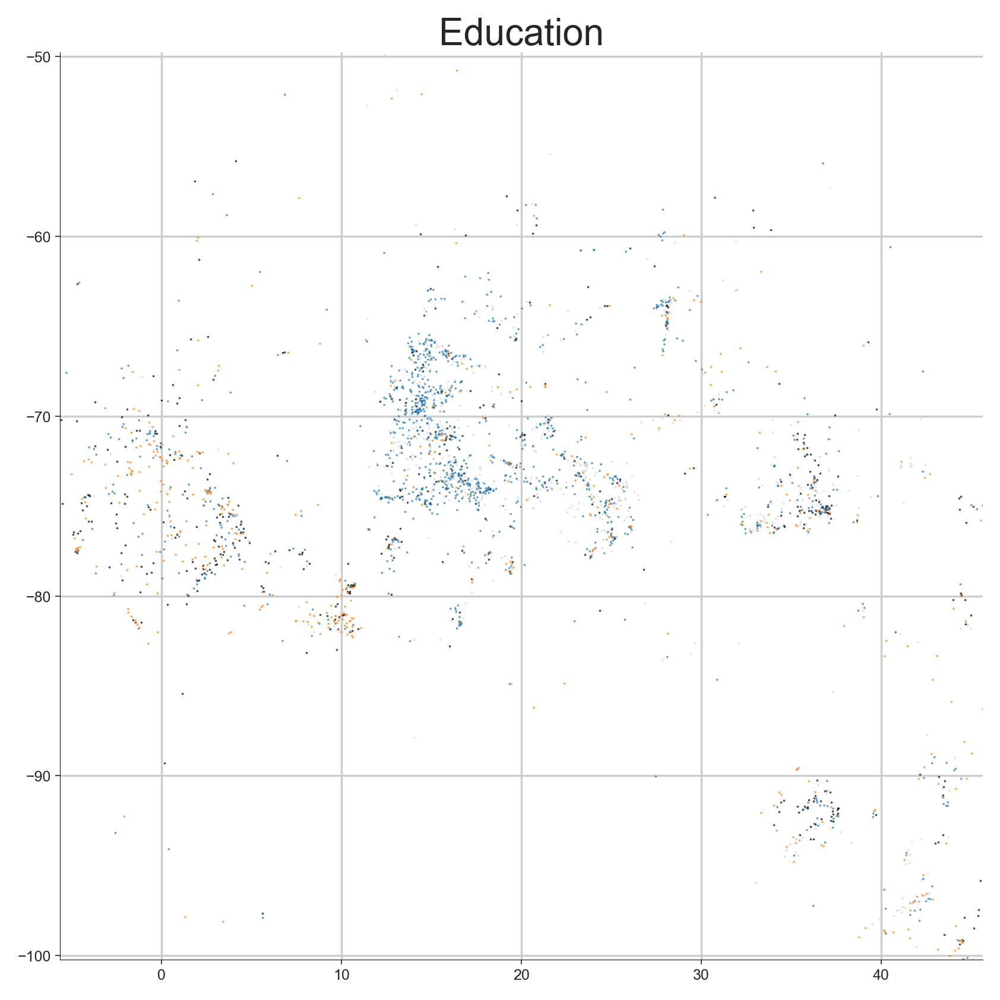

In [50]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "education"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (10, 30)
y_lim = (-100, -50)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

In [461]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
left = 10
right = 30
bottom = -80
top = -60

mask_education_male_blob = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) & (colors_new_labels_with_more==colors_new_labels_with_more_legend['education'])

In [462]:
clean_df_updated_reparsed_filtered_with_authors_ISSN.Title[mask_education_male_blob].tolist()[:10]

['Predoctoral fixed implant patient satisfaction outcome and challenges of a clinical implant competency.',
 'Restoration of a fractured central incisor.',
 'Effect of an herbal mouth rinse in preventing periodontal inflammation in an experimental gingivitis model: a pilot study.',
 'Clinical effectiveness of flash teeth whitening, a novel method for teeth bleaching.',
 'Dental Hygiene Faculty Calibration Using Two Accepted Standards for Calculus Detection: A Pilot Study.',
 "Assessment of 'borderline' clinical competence using generalisability and decision studies in dental skills training.",
 'A Review of Casein Phosphopeptide-Amorphous Calcium Phosphate (CPP-ACP) and Enamel Remineralization.',
 'Digital Smile Design Meets the Dento-Facial Analyzer: Optimizing Esthetics While Preserving Tooth Structure.',
 'Expert opinions on nutrition issues in clinical dentistry.',
 'Concepts in critical thinking applied to caries risk assessment in dental education.']

In [468]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, mask_education_male_blob, n=10)

There are 1581 papers.
In this threshold there are 1581 papers.
For threshold = 0.10 [582 410 376 304 267 261 254 245 241 211]
For threshold = 0.10 ['dental' 'implant' 'tooth' 'teeth' 'esthetic' 'restorations' 'dentistry'
 'restorative' 'implants' 'restoration']


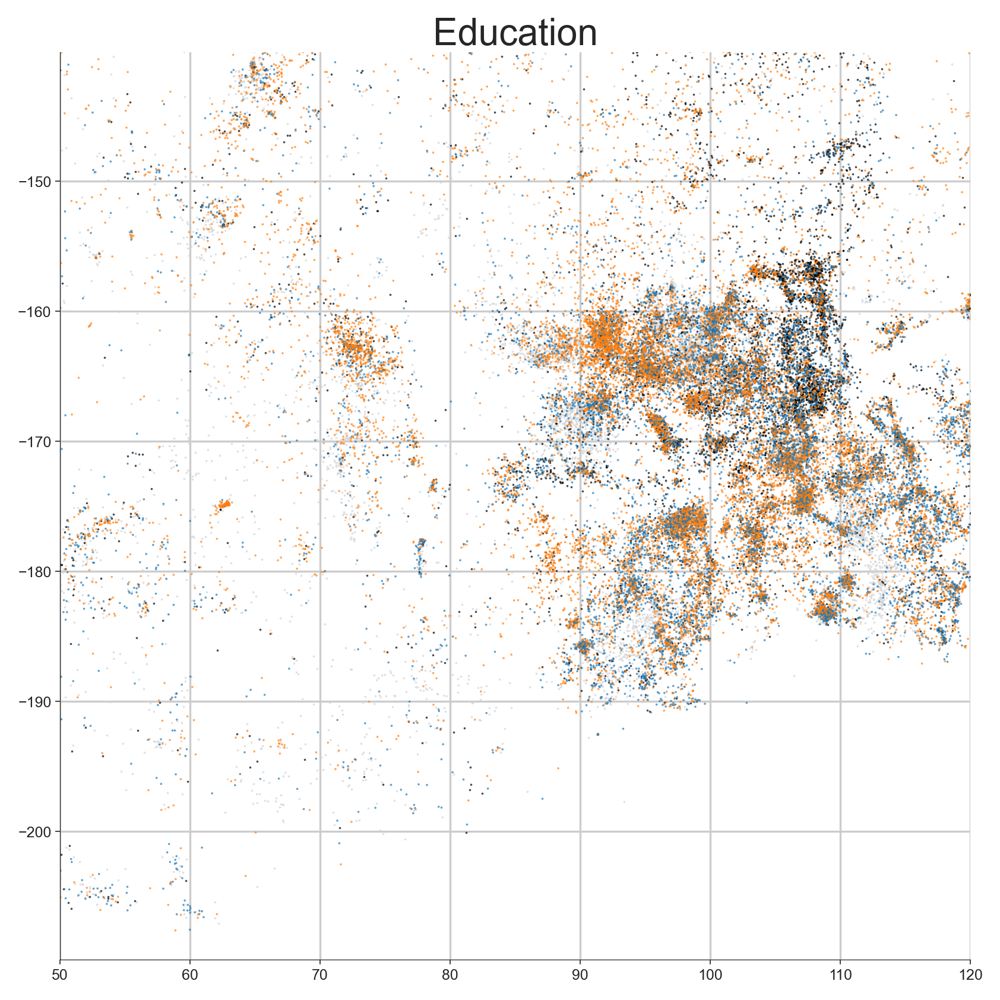

In [51]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "education"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (50, 120)
y_lim = (-200, -150)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

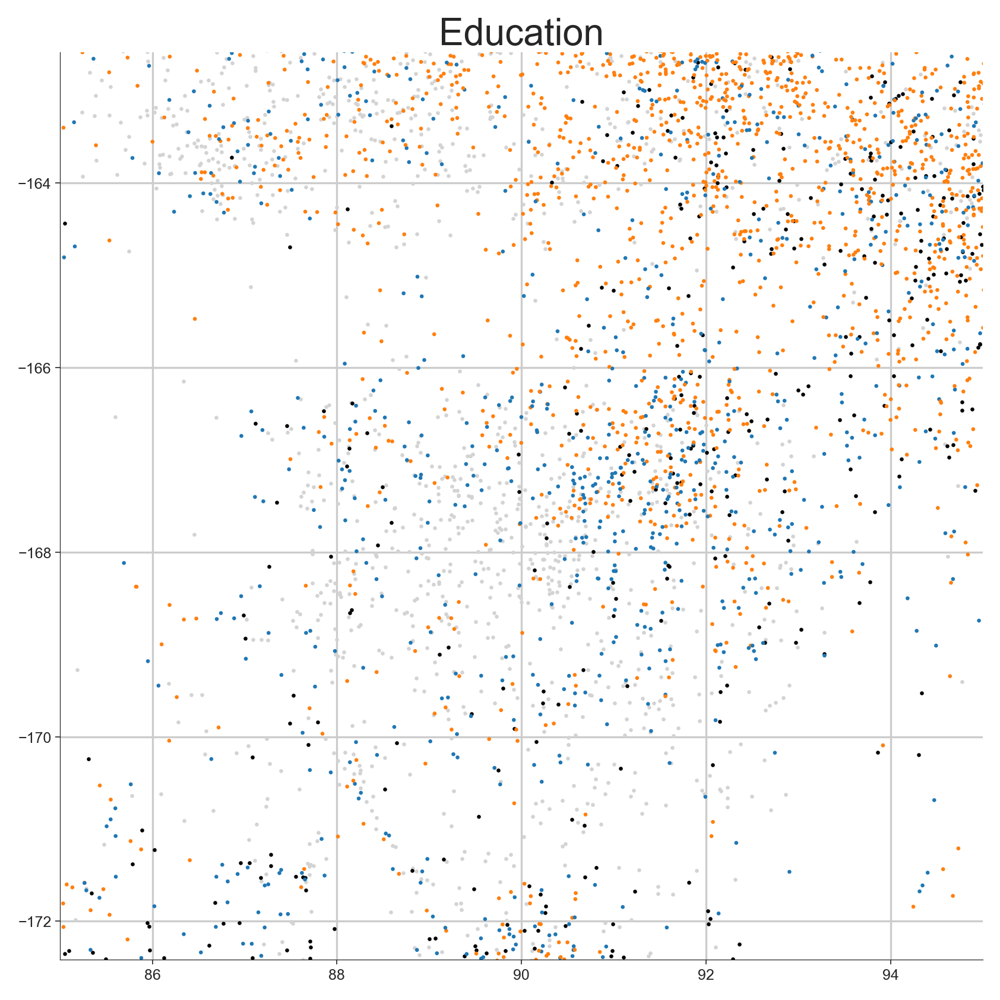

In [53]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "education"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (85, 95)
y_lim = (-170, -165)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="test",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

In [501]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
left = 85
right = 95
bottom = -170
top = -165

mask_education_male_region = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) #& (colors_new_labels_with_more==colors_new_labels_with_more_legend['education'])

In [507]:
clean_df_updated_reparsed_filtered_with_authors_ISSN.Title[mask_education_male_region].tolist()[:10]

['Patient-doctor seminars.',
 'Experience with multiple choice question papers in Nigeria. A practical guide to their use in a new medical school.',
 'Educational videotapes-by and for the teaching department.',
 'Experience with the multiple-choice paper for Part 1 M.R.C.O.G.',
 'Observations on the functioning of committees.',
 'Assessment Driven Integrated Learning (ADIL): Assessment Directed Medical Education (ADME) curriculum.',
 'The evolution of integration: innovations in clinical skills and ethics in first year medicine.',
 'What do we do? Practices and learning strategies of medical education leaders.',
 'Clinical audit in the final year of undergraduate medical education: towards better care of future generations.',
 'Pattern-based formulation: a methodology for psychiatric case formulation.']

In [508]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, mask_education_male_region, n=20)

There are 8137 papers.
In this threshold there are 8137 papers.
For threshold = 0.10 [2070 2046 2033 1945 1842 1648 1233 1219 1182  929  926  901  859  828
  807  802  755  704  692  650]
For threshold = 0.10 ['medical' 'education' 'students' 'training' 'learning' 'teaching'
 'curriculum' 'practice' 'skills' 'undergraduate' 'educational'
 'professional' 'doctors' 'health' 'programme' 'student' 'postgraduate'
 'medicine' 'trainees' 'care']


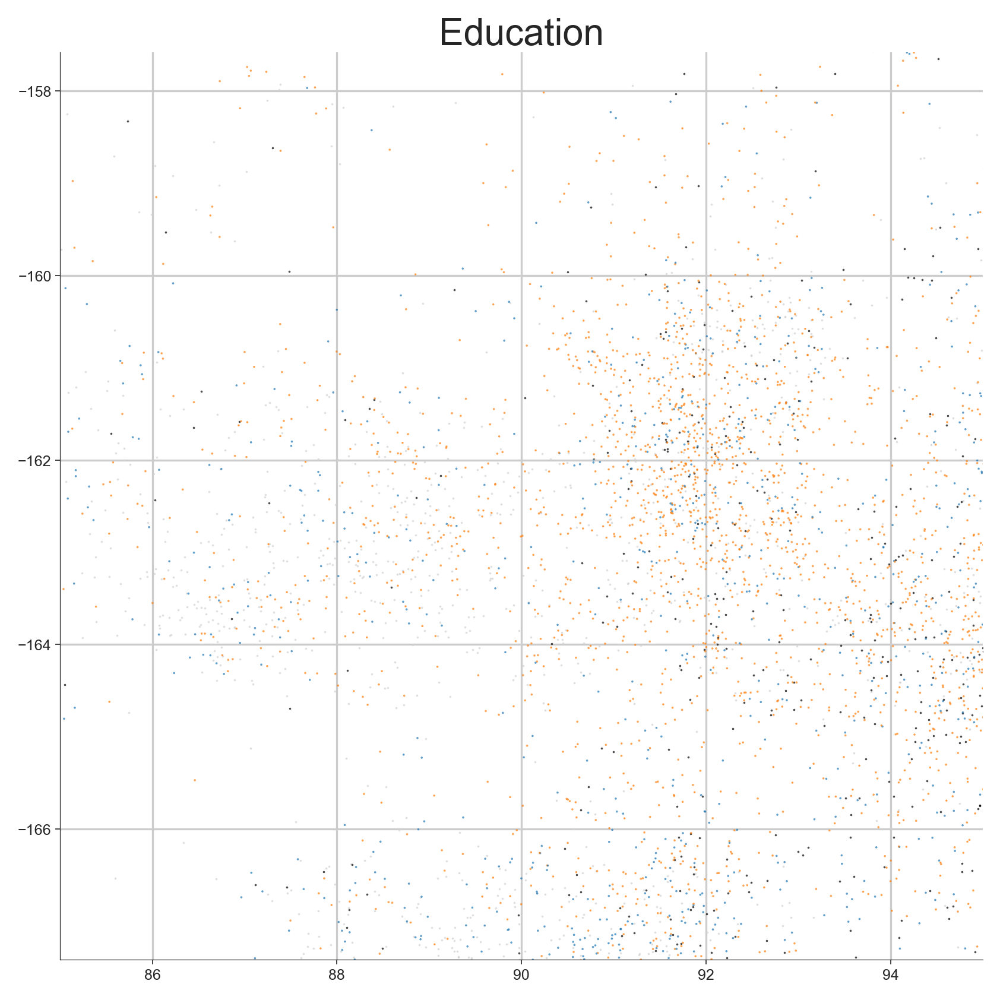

In [54]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "education"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (85, 95)
y_lim = (-165, -160)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

In [497]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
left = 85
right = 95
bottom = -165
top = -160

mask_education_female_region = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) #& (colors_new_labels_with_more==colors_new_labels_with_more_legend['education'])

In [498]:
clean_df_updated_reparsed_filtered_with_authors_ISSN.Title[mask_education_female_region].tolist()[:10]

['School nursing in New Zealand: a study of services.',
 'Exploring clinical wisdom in nursing education.',
 'Responsibilities of nursing schools with regard to peer mentoring.',
 'Untangling a complex issue: an overview of initiatives to support nursing and midwifery student recruitment, selection and retention in Scottish Universities.',
 "The negative influence of significant others on high academic achieving school pupils' choice of nursing as a career.",
 "Antenatal group care in a midwifery group practice--a midwife' perspective.",
 'Increasing student involvement and learning through using debate as an assessment.',
 'Using vignettes to teach stroke care.',
 'Transformational leadership can improve workforce competencies.',
 'The role of the clinical research nurse.']

In [509]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, mask_education_female_region, n=20)

There are 10851 papers.
In this threshold there are 10851 papers.
For threshold = 0.10 [5115 4181 3265 3181 2546 2432 2421 2012 1749 1445 1350 1330 1201 1138
 1061 1034 1002  896  896  869]
For threshold = 0.10 ['nursing' 'students' 'nurses' 'practice' 'learning' 'education' 'nurse'
 'student' 'professional' 'skills' 'care' 'health' 'midwifery' 'programme'
 'undergraduate' 'teaching' 'experiences' 'research' 'training' 'clinical']


#### Nutrition

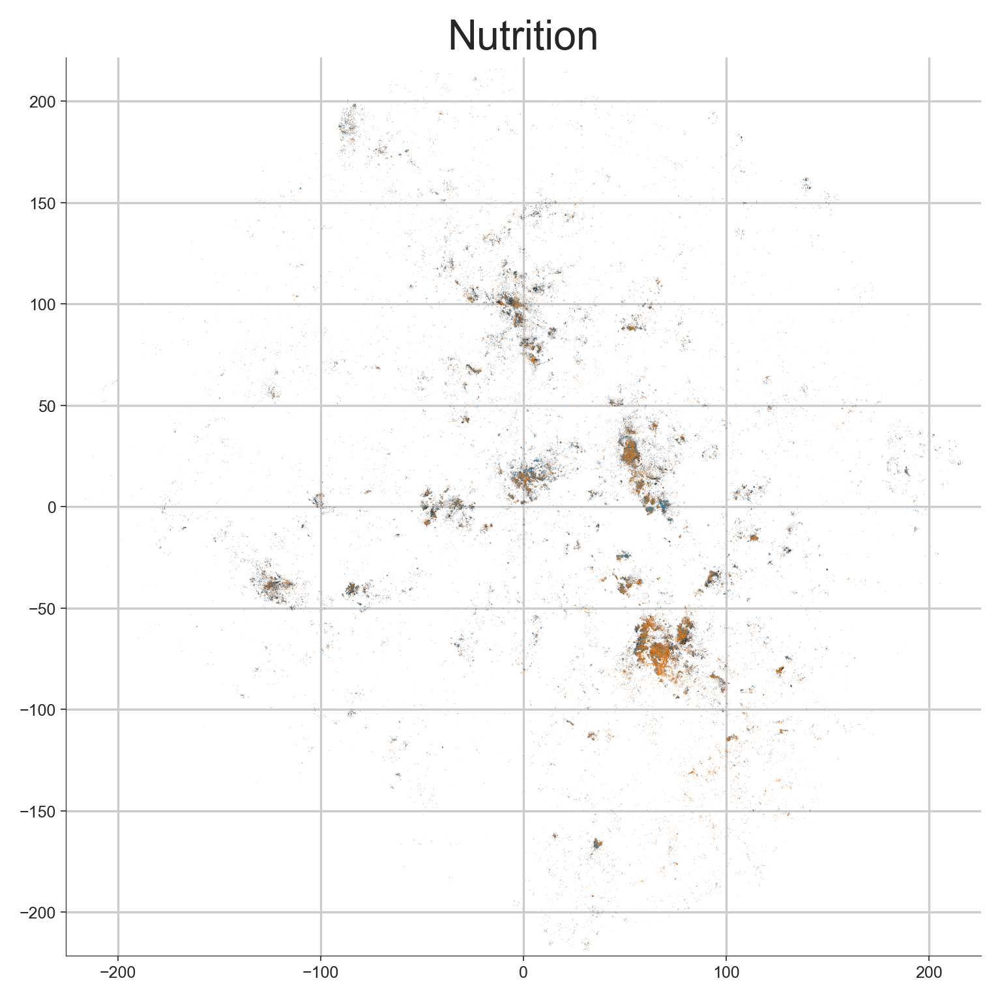

In [55]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5, 5), dpi=300, layout="constrained")

label = "nutrition"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (-220, 220)
y_lim = (-220, 220)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

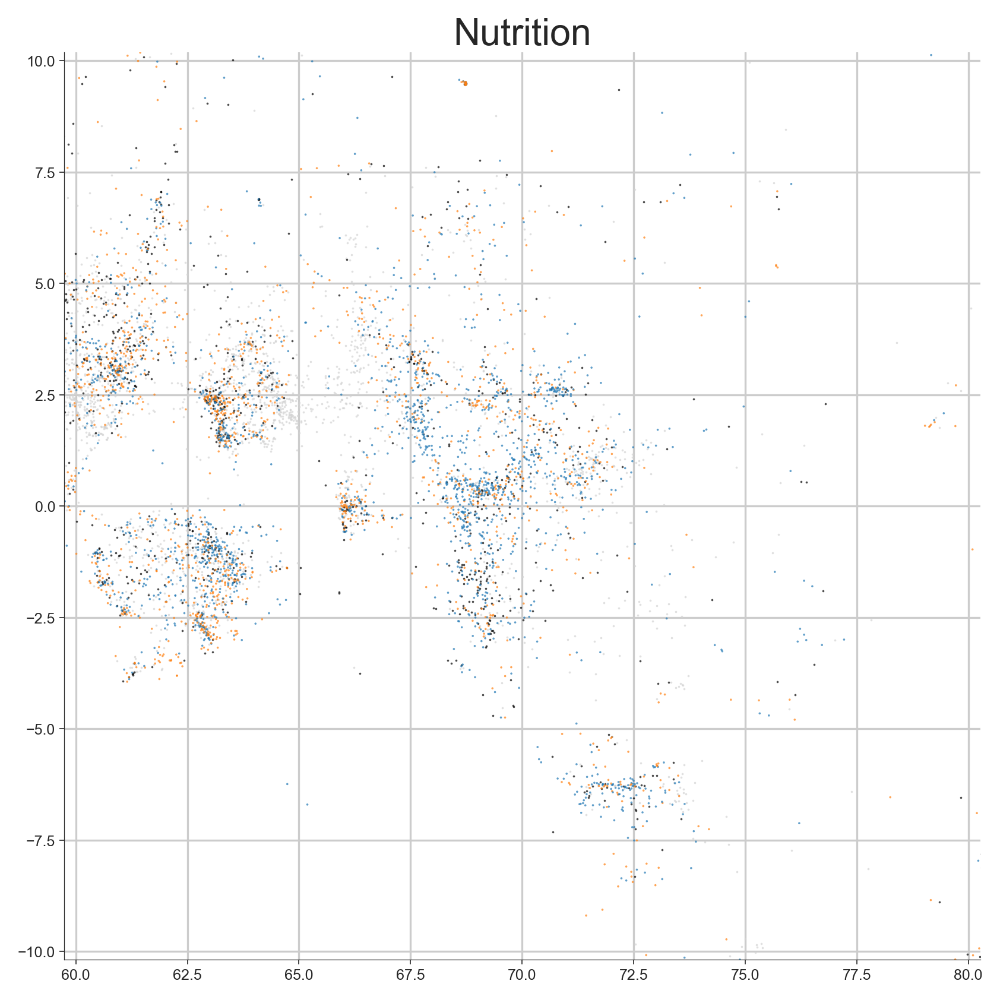

In [56]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "nutrition"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (65, 75)
y_lim = (-10, 10)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

In [519]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
left = 65
right = 75
bottom = -10
top = 10

mask_nutrition_male_blob = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) & (colors_new_labels_with_more==colors_new_labels_with_more_legend['nutrition'])

In [521]:
clean_df_updated_reparsed_filtered_with_authors_ISSN.Title[mask_nutrition_male_blob].tolist()[:10]

['Ingesting a pre-workout supplement containing caffeine, B-vitamins, amino acids, creatine, and beta-alanine before exercise delays fatigue while improving reaction time and muscular endurance.',
 'Effect of betaine supplementation on cycling sprint performance.',
 'An increased fluid intake leads to feet swelling in 100-km ultra-marathoners - an observational field study.',
 'Acute and chronic watercress supplementation attenuates exercise-induced peripheral mononuclear cell DNA damage and lipid peroxidation.',
 'Effects of pre-exercise feeding on serum hormone concentrations and biomarkers of myostatin and ubiquitin proteasome pathway activity.',
 'Dietary prescription adherence and non-structured physical activity following weight loss with and without aerobic exercise.',
 'Effect of diet composition on acid-base balance in adolescents, young adults and elderly at rest and during exercise.',
 'Effect of energy and protein intake and exercise intensity on the thermic effect of food.

In [520]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, mask_nutrition_male_blob, n=20)

There are 2862 papers.
In this threshold there are 2862 papers.
For threshold = 0.10 [1422  601  511  484  473  472  457  442  441  417  373  368  320  306
  267  266  261  257  256  230]
For threshold = 0.10 ['exercise' 'supplementation' 'placebo' 'fat' 'intake' 'min' 'training'
 'kg' 'muscle' 'body' 'carbohydrate' 'energy' 'ingestion' 'athletes'
 'endurance' 'dietary' 'diet' 'cho' 'performance' 'strength']


#### Healthcare

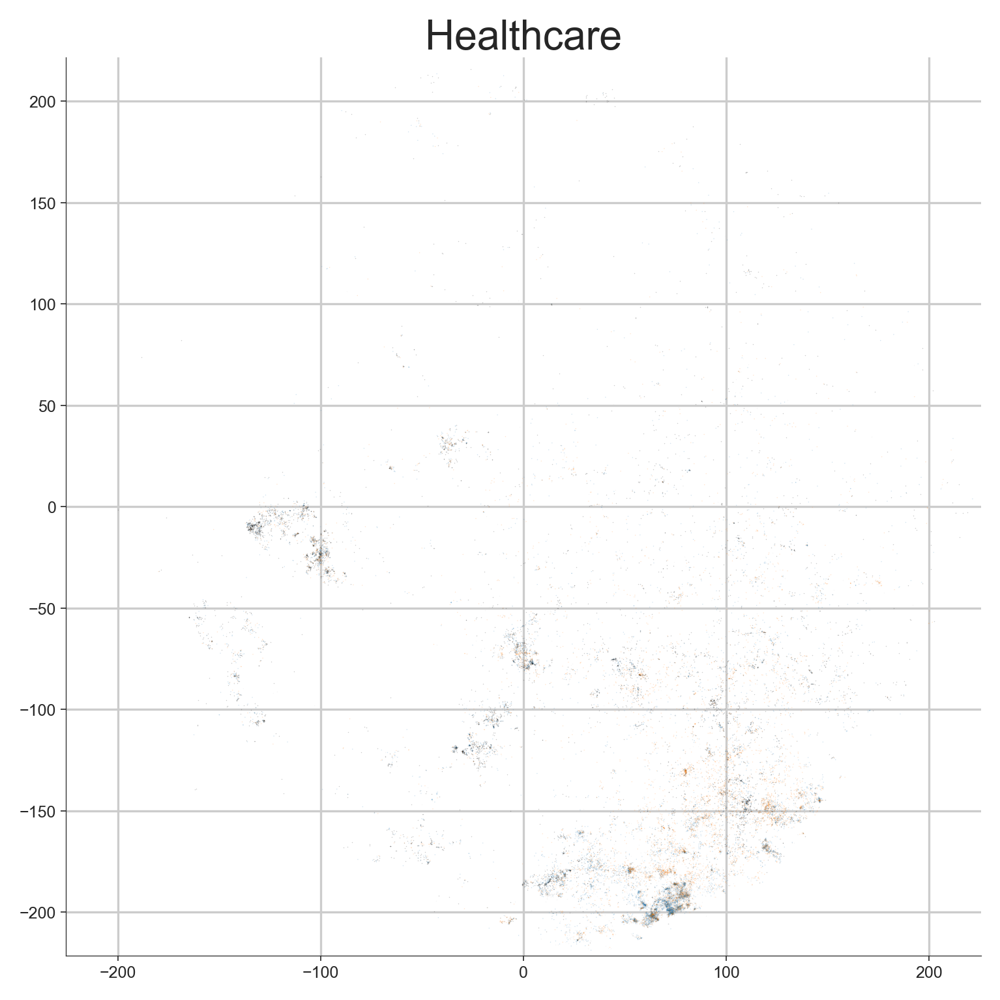

In [57]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5, 5), dpi=300, layout="constrained")

label = "healthcare"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (-220, 220)
y_lim = (-220, 220)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

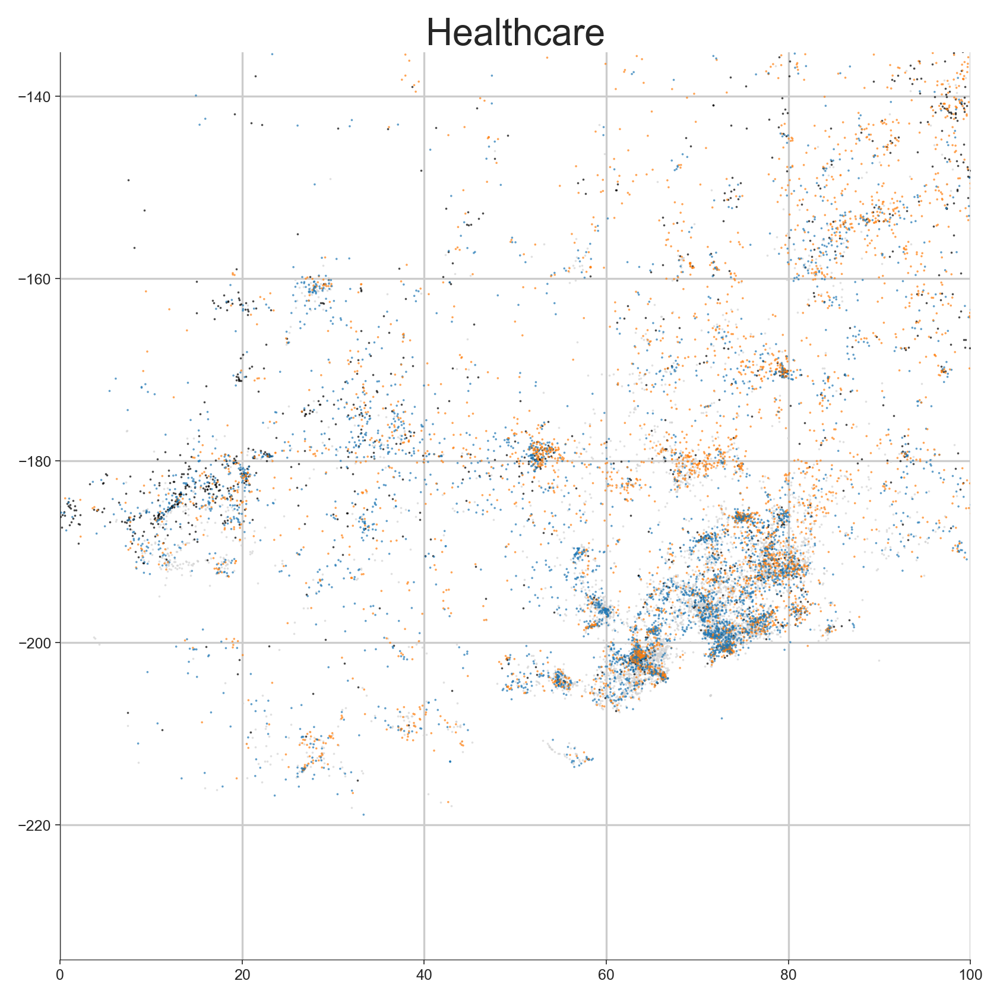

In [59]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "healthcare"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (0, 100)
y_lim = (-220, -150)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

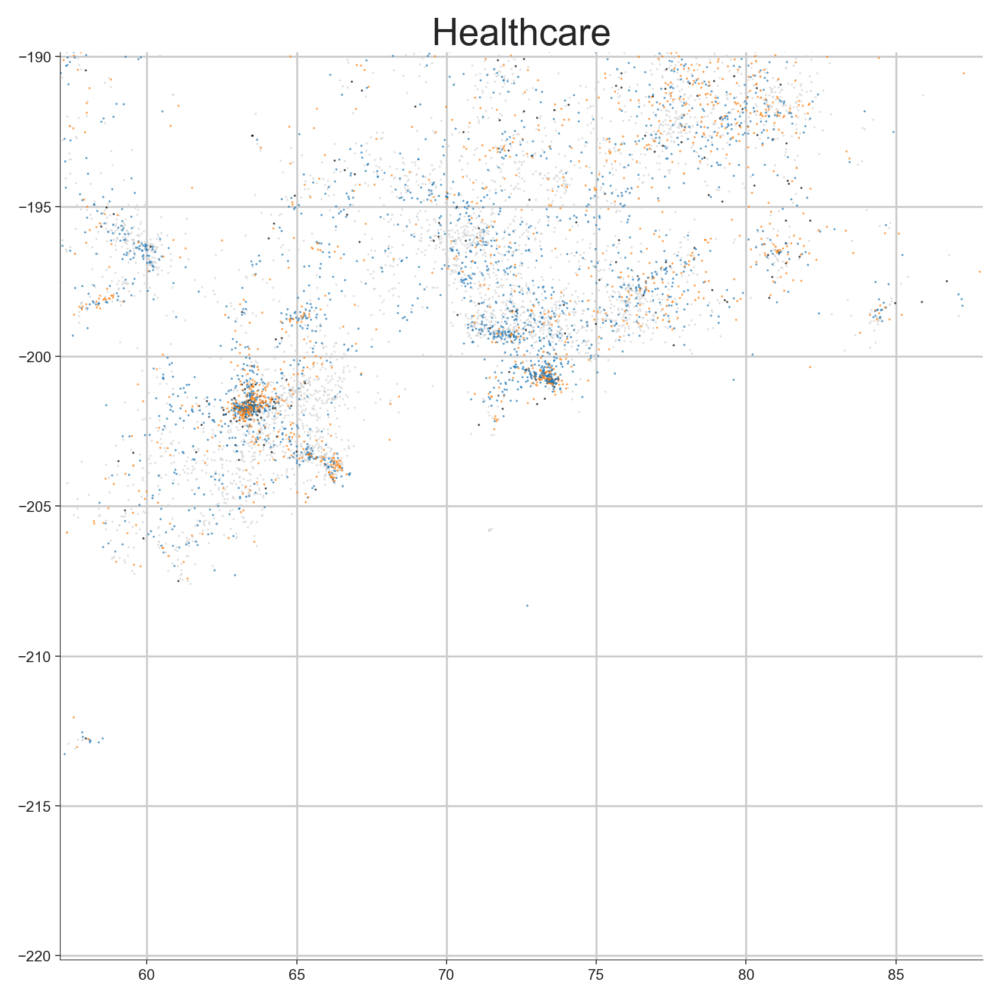

In [60]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "healthcare"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (65, 80)
y_lim = (-220, -190)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

In [526]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
left = 65
right = 80
bottom = -220
top = -190

mask_healthcare_male_blob = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) 
#& (colors_new_labels_with_more==colors_new_labels_with_more_legend['nutrition'])

In [527]:
clean_df_updated_reparsed_filtered_with_authors_ISSN.Title[mask_healthcare_male_blob].tolist()[:10]

['Quality assurance for hospital pharmacy. Part I: Basic concepts.',
 'Obstacles to utilization of prepaid mental health care.',
 'Protecting the medical commons: who is responsible?',
 'A guide to the use of Procedural Terminology for Psychiatrists.',
 'Increasing hospital-community contact through a theater program in a psychiatric hospital.',
 'Cost-financed mental health facility. III. Economic issues and implications for future patterns of health care.',
 'The Quebec health care system: its implication for medical education.',
 'State regulation of health care costs.',
 'Optimizing health care delivery by integrating workplaces, homes, and communities: how occupational and environmental medicine can serve as a vital connecting link between accountable care organizations and the patient-centered medical home.',
 'Incorporating national priorities into the curriculum.']

In [535]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, mask_healthcare_male_blob, n=20)#, several_th = True)

There are 31696 papers.
In this threshold there are 31696 papers.
For threshold = 0.10 [13825  9997  4723  4545  4212  4140  3751  3719  3637  3523  3386  3260
  3107  3054  2986  2880  2880  2842  2819  2809]
For threshold = 0.10 ['care' 'health' 'quality' 'services' 'costs' 'cost' 'organizations'
 'hospitals' 'healthcare' 'medicare' 'providers' 'physicians' 'payment'
 'medical' 'financial' 'managed' 'hospital' 'physician' 'will' 'insurance']


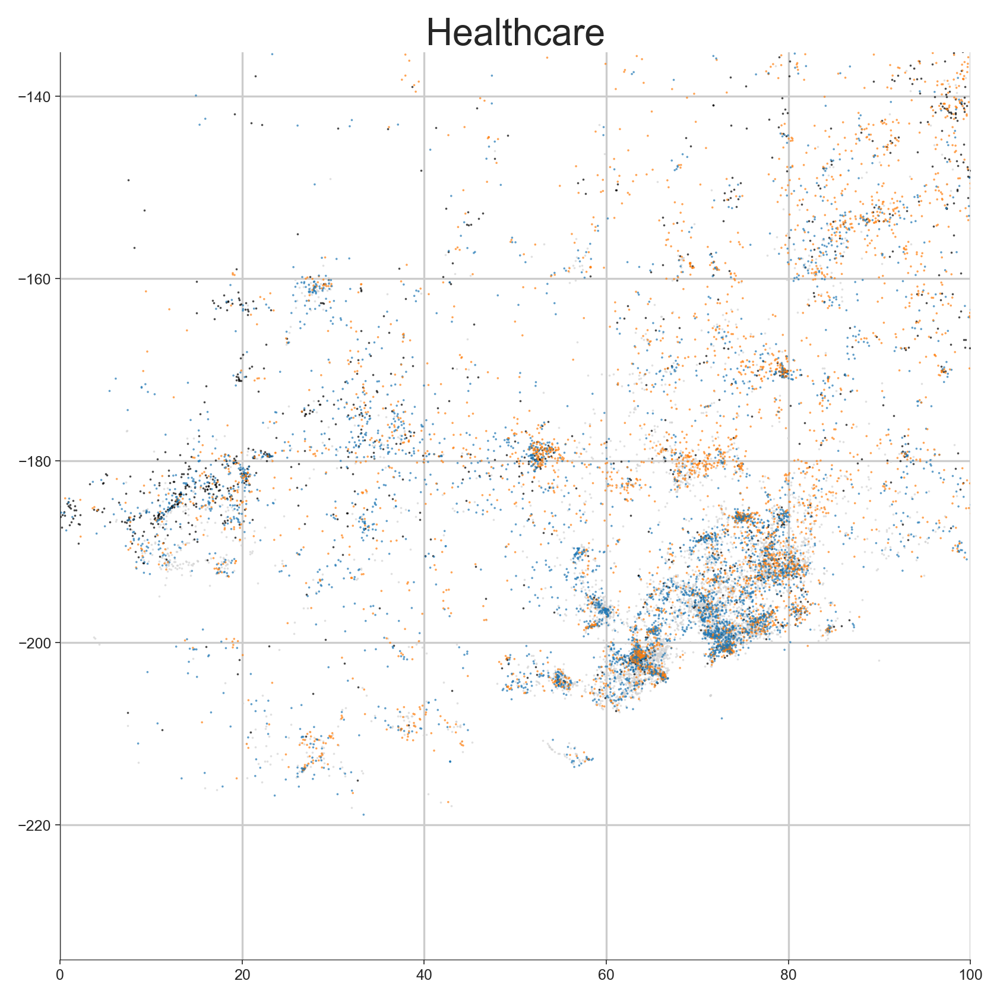

In [59]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "healthcare"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (0, 100)
y_lim = (-220, -150)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

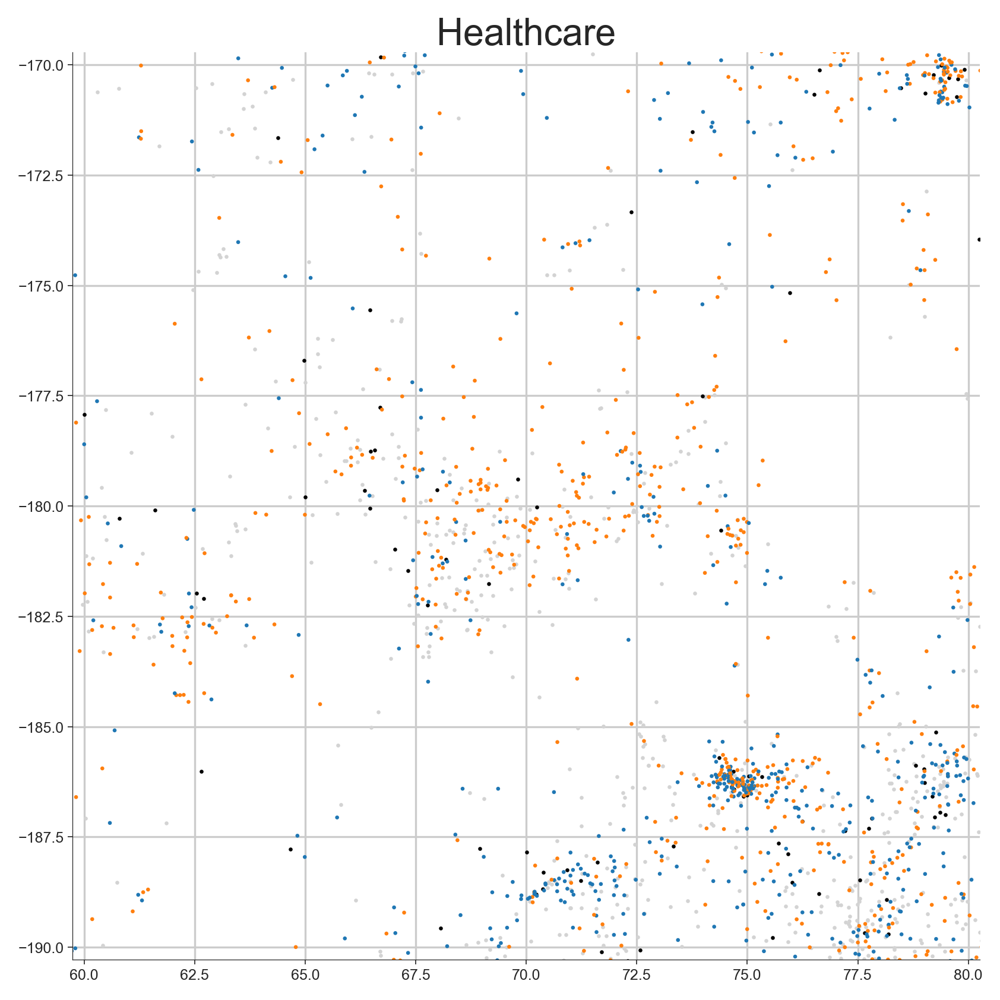

In [62]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "healthcare"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (60, 80)
y_lim = (-190, -170)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="test",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

In [529]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
left = 65
right = 80
bottom = -190
top = -170

mask_healthcare_female_blob = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) 
#& (colors_new_labels_with_more==colors_new_labels_with_more_legend['nutrition'])

In [530]:
clean_df_updated_reparsed_filtered_with_authors_ISSN.Title[mask_healthcare_female_blob].tolist()[:10]

['Future health professional practice in America.',
 'Measuring of the quality of health care: a decision oriented typology.',
 'Challenging residents to assume maximal responsibilities in homes for the aged.',
 'Economic and noneconomic barriers to the use of needed medical services.',
 'A study of consumer attitudes about health care: the delivery of ambulatory services.',
 'Orthotics research evaluation framework.',
 'Mental health training and consultation with suburban police.',
 'Illinois: Community mental health: a noble failure?',
 "California: Orange County's alternative to state hospital treatment.",
 'The measurement and utility of the opinion leadership concept for family planning programs.']

In [533]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, mask_healthcare_female_blob, n=20)

There are 34389 papers.
In this threshold there are 34389 papers.
For threshold = 0.10 [11761  9367  4584  3860  3152  3062  2803  2653  2596  2568  2540  2496
  2465  2428  2341  2283  2232  2203  2201  2095]
For threshold = 0.10 ['care' 'health' 'services' 'research' 'article' 'practice' 'nursing'
 'program' 'community' 'programs' 'hospitals' 'home' 'hospital'
 'organizations' 'management' 'patient' 'needs' 'healthcare' 'quality'
 'organizational']


#### Psychology

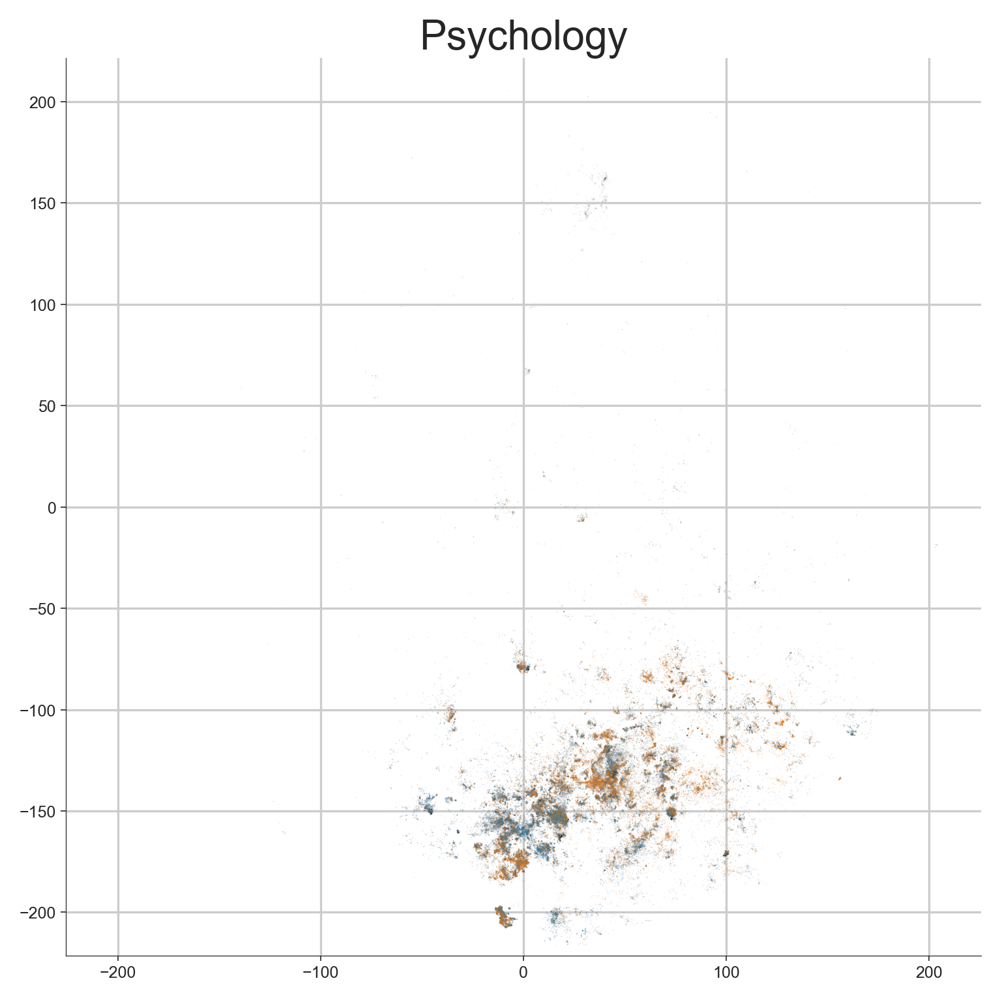

In [63]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5, 5), dpi=300, layout="constrained")

label = "psychology"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (-220, 220)
y_lim = (-220, 220)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

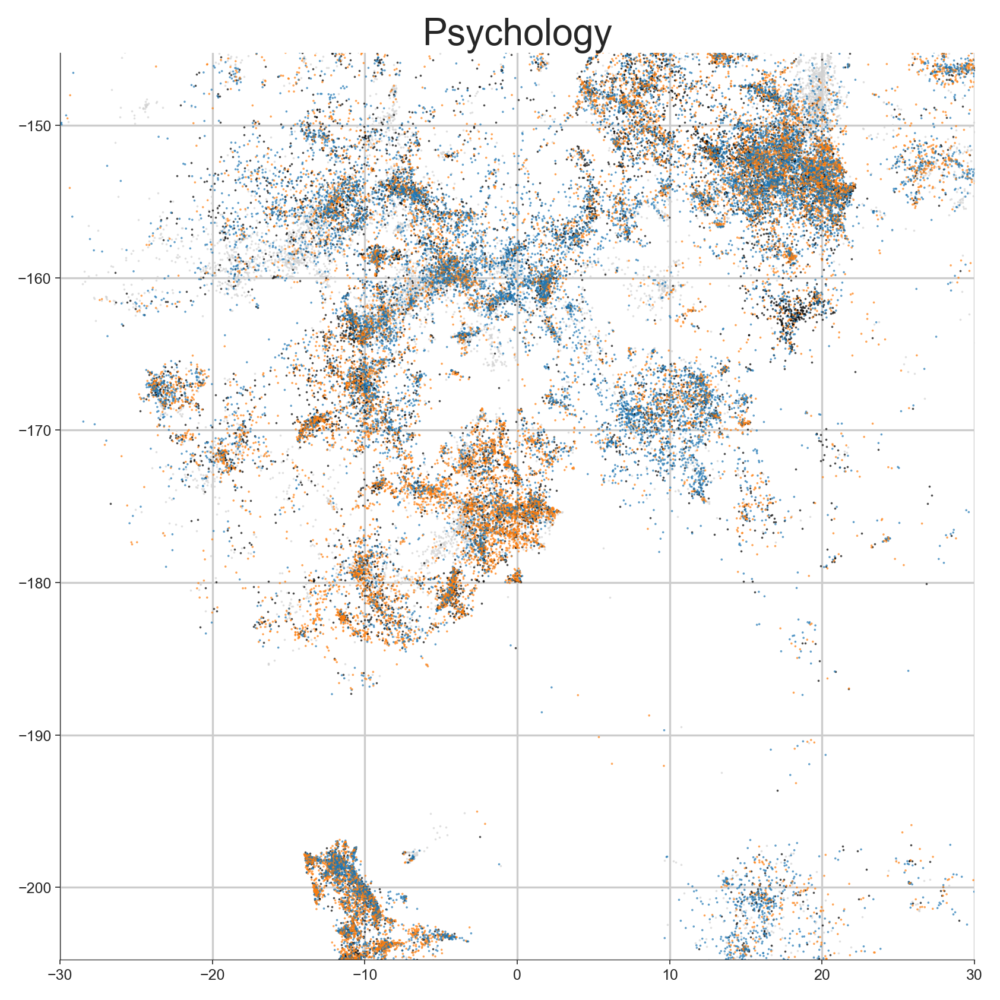

In [64]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "psychology"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (-30, 30)
y_lim = (-200, -150)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

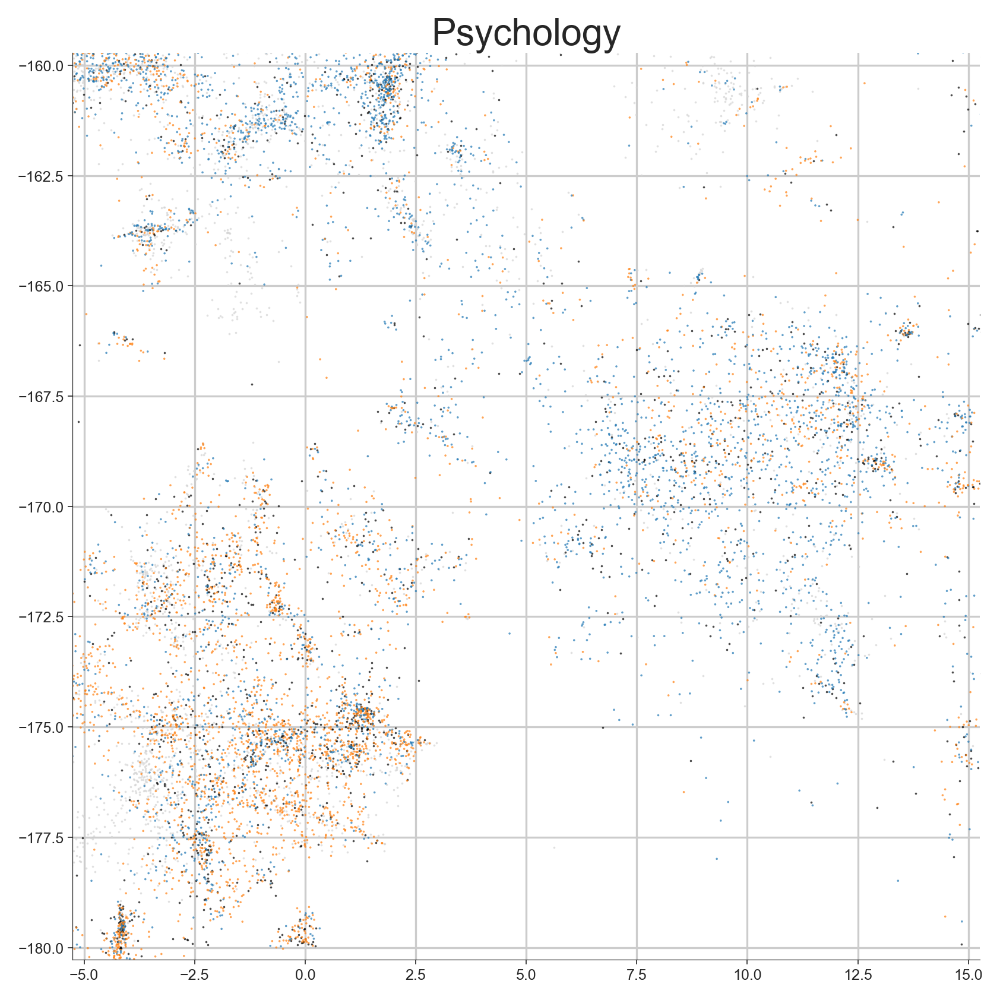

In [65]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "psychology"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (-5, 15)
y_lim = (-180, -160)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

In [549]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
left = -5
right = 15
bottom = -180
top = -160

mask_psychology_male_blob = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) 
#& (colors_new_labels_with_more==colors_new_labels_with_more_legend['nutrition'])

In [550]:
clean_df_updated_reparsed_filtered_with_authors_ISSN.Title[mask_psychology_male_blob].tolist()[:10]

['Transfer of the "same-different\' differentiation task in dogs.',
 'Attitudes toward age: an exploration in school-age children.',
 'The case history of a happy child.',
 'The sociability of two-year-olds with their mothers and fathers.',
 'A mother-instruction program: Documenting change in mother-child interactions.',
 'Early child development in the context of mothering experiences.',
 'Some structural aspects of deviant child behavior.',
 'Effects of within-stimulus and extra-stimulus prompting on discrimination learning  in autistic children.',
 'A life-span look at person perception and its relationship to communicative interaction.',
 'Some new perspectives on conditioned hunger.']

In [551]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, mask_psychology_male_blob, n=20)#, several_th = True)

There are 49865 papers.
In this threshold there are 49865 papers.
For threshold = 0.10 [9055 4036 3924 3904 3870 3507 3332 3158 3141 3063 3050 2494 2394 2352
 2340 2256 2218 2182 2161 2154]
For threshold = 0.10 ['children' 'social' 'cognitive' 'infants' 'learning' 'olds' 'task'
 'experiment' 'theory' 'behavior' 'memory' 'psychology' 'objects' 'argue'
 'object' 'cognition' 'theories' 'how' 'tasks' 'research']


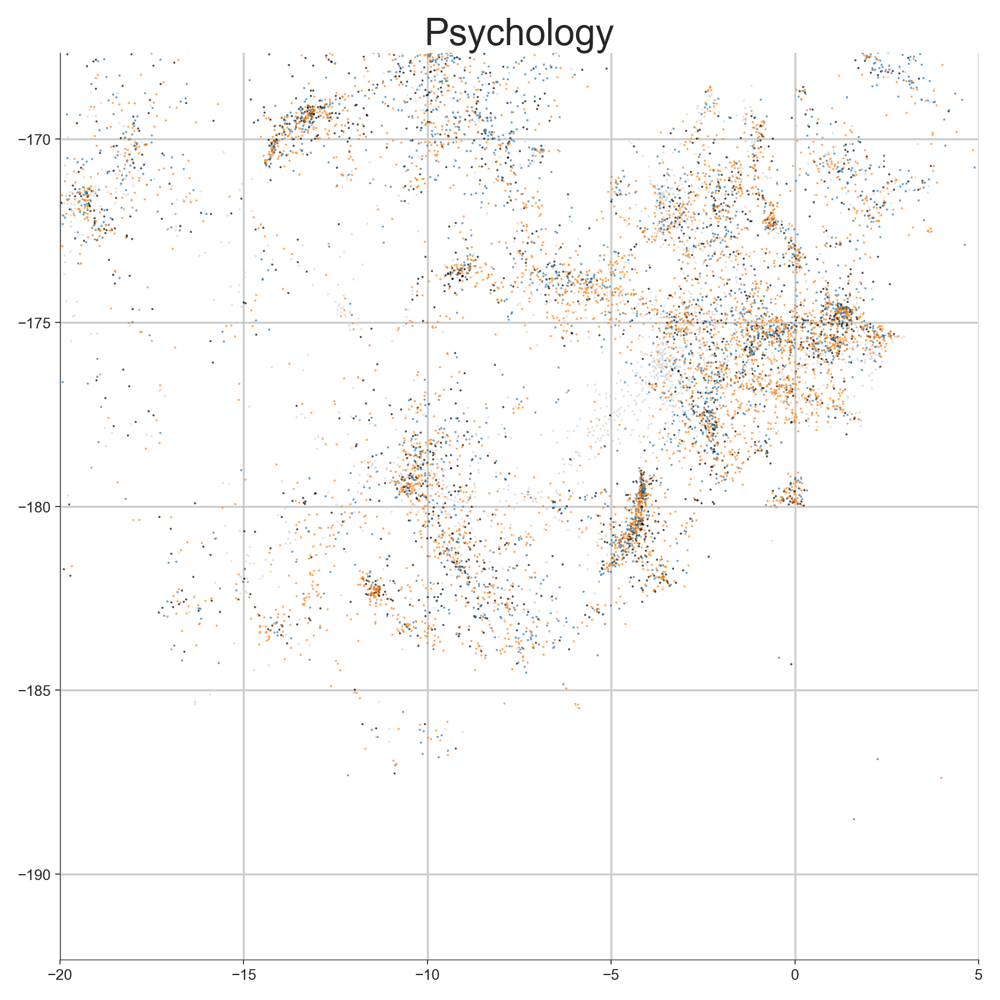

In [66]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "psychology"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (-20, 5)
y_lim = (-190, -170)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

In [552]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
left = -20
right = 5
bottom = -190
top = -170

mask_psychology_female_blob = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) 
#& (colors_new_labels_with_more==colors_new_labels_with_more_legend['nutrition'])

In [553]:
clean_df_updated_reparsed_filtered_with_authors_ISSN.Title[mask_psychology_female_blob].tolist()[:10]

['Dyslexia: patterns of disability and recovery.',
 'Attitudes toward age: an exploration in school-age children.',
 'A multilingual self-administered symptom history.',
 'The case history of a happy child.',
 'The sociability of two-year-olds with their mothers and fathers.',
 'Early child development in the context of mothering experiences.',
 'Collaborative study of speaker identiication by the voiceprint method.',
 'A life-span look at person perception and its relationship to communicative interaction.',
 'Egocentrism and conformity in childhood.',
 'Effects of structural variations in elaboration on learning by EMR and nonretarded children.']

In [554]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, mask_psychology_female_blob, n=20)#, several_th = True)

There are 58263 papers.
In this threshold there are 58263 papers.
For threshold = 0.10 [20912 13264  7781  7495  6897  6145  5556  5432  5229  4733  4616  4305
  4282  4151  4080  4073  3887  3765  3630  3484]
For threshold = 0.10 ['children' 'language' 'speech' 'word' 'reading' 'words' 'learning'
 'phonological' 'task' 'olds' 'infants' 'skills' 'processing'
 'comprehension' 'linguistic' 'tasks' 'semantic' 'lexical' 'memory'
 'vocabulary']


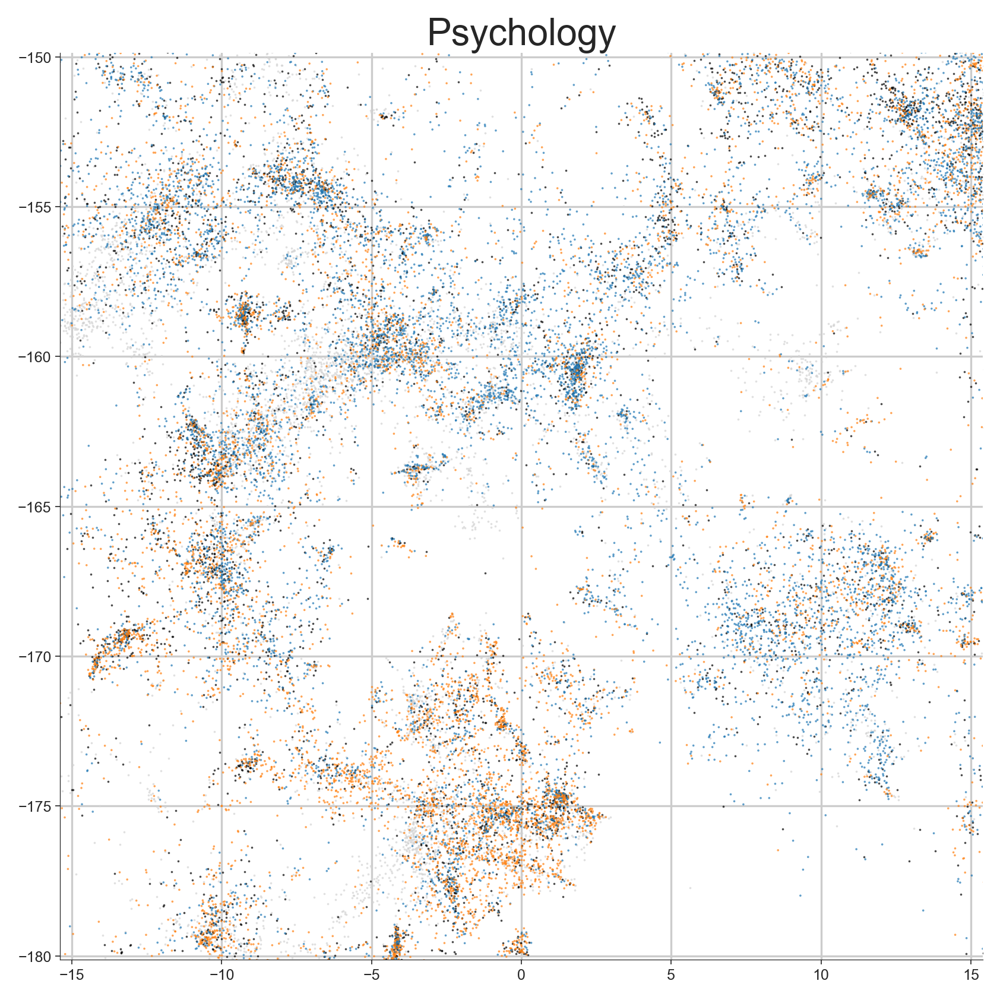

In [67]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

label = "psychology"

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

tsne_label = tsne[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
gender_label = gender_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]
colors_label = colors_first_author[
    colors_new_labels_with_more == colors_new_labels_with_more_legend[label]
]

x_lim = (-15, 15)
y_lim = (-180, -150)
plot_tsne_genders(
    tsne_label,
    colors_label,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    plot_type="zoom",
    legend=False,
    axis_on=True,
)
ax.set_title(label.capitalize(), fontsize=15)
ax.grid()

In [556]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
left = -5
right = 5
bottom = -165
top = -155

mask_psychology_male_upper_blob = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) 
#& (colors_new_labels_with_more==colors_new_labels_with_more_legend['nutrition'])

In [557]:
clean_df_updated_reparsed_filtered_with_authors_ISSN.Title[mask_psychology_male_upper_blob].tolist()[:10]

['Transfer of the "same-different\' differentiation task in dogs.',
 'Effects of within-stimulus and extra-stimulus prompting on discrimination learning  in autistic children.',
 'Some new perspectives on conditioned hunger.',
 'Lateral asymmetry of retroactive inhibition in a psychomotor skill.',
 'Oral stereognosis: effect of varying form set, answer type, and retention time.',
 'Role of naming in delayed matching-to-sample.',
 'Teaching a simple reading vocabulary to retarded children: effectiveness of fading and nonfading procedures.',
 'Discrete trial analysis of drug action.',
 'The role of reward in dynamic decision making.',
 'Rapidly measuring the speed of unconscious learning: amnesics learn quickly and happy people slowly.']

In [558]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, mask_psychology_male_upper_blob, n=20)#, several_th = True)

There are 15629 papers.
In this threshold there are 15629 papers.
For threshold = 0.10 [2951 2464 2257 2152 1695 1690 1379 1331 1246 1231 1224 1203 1185 1178
 1163 1075 1070 1047  983  940]
For threshold = 0.10 ['memory' 'learning' 'task' 'experiment' 'participants' 'decision' 'tasks'
 'stimulus' 'recall' 'stimuli' 'model' 'judgments' 'items' 'choice'
 'information' 'experiments' 'retrieval' 'cognitive' 'performance'
 'models']


## Last authors

In [68]:
gender_last_author = year_name_gender_last_author_df.Gender.to_numpy()
gender_last_author

array(['unknown', 'unknown', 'unknown', ..., 'male', 'female', 'unknown'],
      dtype=object)

In [69]:
name_last_author = year_name_gender_last_author_df.Names.to_numpy()
name_last_author

array(['', '', '', ..., 'Hans', 'Federica', 'Ye'], dtype=object)

In [70]:
print(
    "Number of predicted names: ",
    len(np.where(gender_last_author != "unknown")[0]),
)
print(
    "Number of female names: ",
    len(np.where(gender_last_author == "female")[0]),
)
print("Number of male names: ", len(np.where(gender_last_author == "male")[0]))

Number of predicted names:  8468165
Number of female names:  2464882
Number of male names:  6003283


In [71]:
unknown_name_mask_last = (gender_last_author == "unknown") & (
    name_last_author == ""
)
unknown_gender_mask_last = (gender_last_author == "unknown") & (
    name_last_author != ""
)

In [72]:
%%time
colors_last_author = np.where(
    unknown_name_mask_last, "lightgrey", name_last_author
)
colors_last_author = np.where(
    unknown_gender_mask_last, "black", colors_last_author
)
colors_last_author = np.where(
    gender_last_author == "female", "tab:orange", colors_last_author
)
colors_last_author = np.where(
    gender_last_author == "male", "tab:blue", colors_last_author
)
colors_last_author

CPU times: user 1.83 s, sys: 1.34 ms, total: 1.83 s
Wall time: 1.83 s


array(['lightgrey', 'lightgrey', 'lightgrey', ..., 'tab:blue',
       'tab:orange', 'black'], dtype=object)

In [73]:
np.save(variables_path / "colors_gender_last_author", colors_last_author)

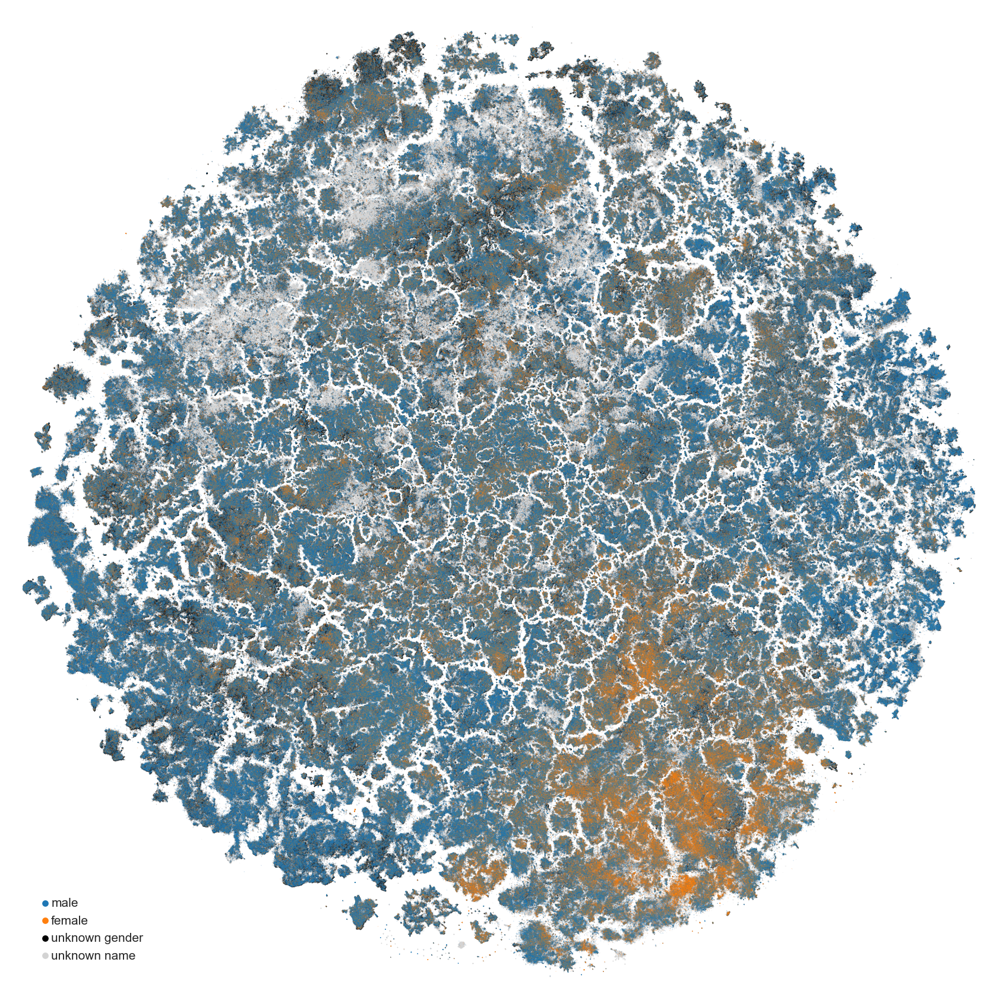

In [74]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

x_lim = (-220, 220)
y_lim = (-220, 220)
plot_tsne_genders(
    tsne, colors_last_author, x_lim=x_lim, y_lim=y_lim, ax=ax, legend=True
)

# fig.savefig(figures_path / "tsne_colored_by_gender_last_author.png")

# Fraction of female in islands

## Import

In [51]:
tsne_reparsed=np.load(variables_path / "bert/tsne_reparsed.npy")

In [52]:
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 

In [53]:
# load
# legend colors
pickle_in = open(variables_path / "colors_new_legend.pkl","rb")
colors_new_legend = pickle.load(pickle_in)

colors_new = np.load(variables_path / "colors_new.npy", allow_pickle = True)

In [54]:
colors_gender_first_author = np.load(variables_path / 'colors_gender_first_author.npy', allow_pickle = True)

## Surgery

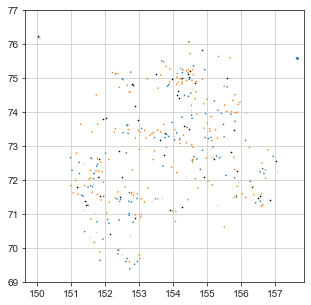

In [73]:
%matplotlib inline
fig, ax6 = plt.subplots(figsize=(5, 5))
plot_tsne_genders(tsne[colors_new == colors_new_legend['surgery']], colors_gender_first_author[colors_new == colors_new_legend['surgery']],
                  x_lim=(150,157.5), y_lim=(69,77), ax = ax6, plot_type='test', legend=False, axis_on=True)

#ax6.set_xticks([])
#ax6.set_yticks([])
ax6.grid()

In [75]:
#mask 
right = 157.5
left = 150
top = 77
bottom = 69
mask_surgery_female_island = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) & (colors_new == colors_new_legend['surgery'])

In [76]:
print_numbers_names(names_first_author[mask_surgery_female_island], gender_first_author[mask_surgery_female_island], names_last_author[mask_surgery_female_island], gender_last_author[mask_surgery_female_island])

Number of available first author names:  322
Number of predicted first author names:  275
Number of female first author names:  168
% of available first author names:  91.47727272727273
% of predicted first author names:  85.40372670807453
% of female first author names:  61.09090909090909
Number of available last author names:  320
Number of predicted last author names:  268
Number of female last author names:  118
% of available last author names:  90.9090909090909
% of predicted last author names:  83.22981366459628
% of female last author names:  44.02985074626866


## Healthcare 

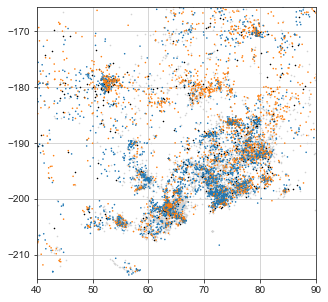

In [77]:
%matplotlib inline
fig, ax4 = plt.subplots(figsize=(5, 5))
plot_tsne_genders(tsne[colors_new == colors_new_legend['healthcare']], colors_gender_first_author[colors_new == colors_new_legend['healthcare']], 
                  x_lim=(40,90), y_lim=(-210,-170), ax = ax4, plot_type='test', legend=False, axis_on=True)

ax4.grid()

In [79]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
left = 65
right = 80
bottom = -220
top = -190

mask_healthcare_male_blob = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) & (colors_new == colors_new_legend['healthcare'])

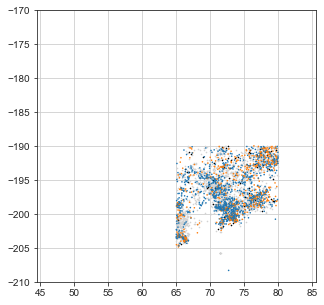

In [80]:
%matplotlib inline
fig, ax4 = plt.subplots(figsize=(5, 5))
plot_tsne_genders(tsne[mask_healthcare_male_blob], colors_gender_first_author[mask_healthcare_male_blob], 
                  x_lim=(40,90), y_lim=(-210,-170), ax = ax4, plot_type='test', legend=False, axis_on=True)

ax4.grid()

In [83]:
print_numbers_names(names_first_author[mask_healthcare_male_blob],
                    gender_first_author[mask_healthcare_male_blob], 
                    names_last_author[mask_healthcare_male_blob], 
                    gender_last_author[mask_healthcare_male_blob])

Number of available first author names:  1878
Number of predicted first author names:  1793
Number of female first author names:  608
% of available first author names:  45.285748734024594
% of predicted first author names:  95.47390841320554
% of female first author names:  33.90964863357501
Number of available last author names:  1869
Number of predicted last author names:  1786
Number of female last author names:  624
% of available last author names:  45.06872437906921
% of predicted last author names:  95.10117145899893
% of female last author names:  34.93840985442329


In [89]:
#mask 
tsne = np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T 
left = 60
right = 80
bottom = -185
top = -170

mask_healthcare_female_blob = (tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) & (colors_new == colors_new_legend['healthcare'])

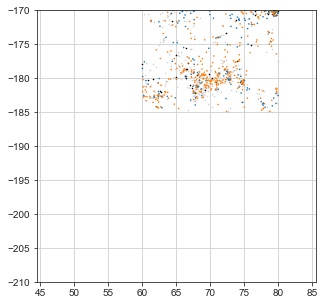

In [90]:
%matplotlib inline
fig, ax4 = plt.subplots(figsize=(5, 5))
plot_tsne_genders(tsne[mask_healthcare_female_blob], colors_gender_first_author[mask_healthcare_female_blob], 
                  x_lim=(40,90), y_lim=(-210,-170), ax = ax4, plot_type='test', legend=False, axis_on=True)

ax4.grid()

In [91]:
print_numbers_names(names_first_author[mask_healthcare_female_blob],
                    gender_first_author[mask_healthcare_female_blob], 
                    names_last_author[mask_healthcare_female_blob], 
                    gender_last_author[mask_healthcare_female_blob])

Number of available first author names:  557
Number of predicted first author names:  520
Number of female first author names:  354
% of available first author names:  66.388557806913
% of predicted first author names:  93.35727109515261
% of female first author names:  68.07692307692308
Number of available last author names:  553
Number of predicted last author names:  507
Number of female last author names:  339
% of available last author names:  65.91179976162098
% of predicted last author names:  91.02333931777379
% of female last author names:  66.86390532544378


# Numbers and percentages of available, predicted, and female authors

## Import

In [25]:
# import clean_df_updated
year_name_gender_first_author_df = pd.read_pickle(
    variables_path / "year_name_gender_first_author_df"
)
year_name_gender_last_author_df = pd.read_pickle(
    variables_path / "year_name_gender_last_author_df"
)

In [26]:
# load
# legend colors
pickle_in = open(variables_path / "colors_new_legend.pkl", "rb")
colors_new_legend = pickle.load(pickle_in)

colors_new = np.load(variables_path / "colors_new.npy", allow_pickle=True)

In [27]:
gender_first_author = year_name_gender_first_author_df.Gender.to_numpy()
gender_first_author

array(['unknown', 'unknown', 'unknown', ..., 'female', 'male', 'unknown'],
      dtype=object)

In [28]:
names_first_author = year_name_gender_first_author_df.Names.to_numpy()
names_first_author

array(['', '', '', ..., 'Indira', 'Giuseppe', 'Huan'], dtype=object)

In [29]:
gender_last_author = year_name_gender_last_author_df.Gender.to_numpy()
gender_last_author

array(['unknown', 'unknown', 'unknown', ..., 'male', 'female', 'unknown'],
      dtype=object)

In [30]:
names_last_author = year_name_gender_last_author_df.Names.to_numpy()
names_last_author

array(['', '', '', ..., 'Hans', 'Federica', 'Ye'], dtype=object)

## Calculation

In [31]:
print_numbers_names(
    names_first_author,
    gender_first_author,
    names_last_author,
    gender_last_author,
)

Number of available first author names:  13429169
Number of predicted first author names:  8363116
Number of female first author names:  3543592
% of available first author names:  64.91551035304525
% of predicted first author names:  62.27575213328539
% of female first author names:  42.37167103744585
Number of available last author names:  13189271
Number of predicted last author names:  8468165
Number of female last author names:  2464882
% of available last author names:  63.75586293907087
% of predicted last author names:  63.05799711061793
% of female last author names:  29.107628394108996


In [35]:
print_numbers_names_label('healthcare', names_first_author, gender_first_author, names_last_author, gender_last_author, colors_new, colors_new_legend)

Number of available first author names:  21931
Number of predicted first author names:  15478
Number of female first author names:  7681
% of available first author names:  78.4034034034034
% of predicted first author names:  70.57589713191373
% of female first author names:  49.62527458327949
Number of available last author names:  21798
Number of predicted last author names:  15447
Number of female last author names:  6619
% of available last author names:  77.92792792792793
% of predicted last author names:  70.43454470840364
% of female last author names:  42.849744286916554


In [37]:
print_numbers_names_label('veterinary', names_first_author, gender_first_author, names_last_author, gender_last_author, colors_new, colors_new_legend)

Number of available first author names:  71337
Number of predicted first author names:  48639
Number of female first author names:  25409
% of available first author names:  45.35467012531233
% of predicted first author names:  68.1820093359687
% of female first author names:  52.23997203889883
Number of available last author names:  70520
Number of predicted last author names:  47628
Number of female last author names:  16912
% of available last author names:  44.83523749578796
% of predicted last author names:  66.76479246393878
% of female last author names:  35.50852439741329


In [46]:
print_numbers_names_label('nursing', names_first_author, gender_first_author, names_last_author, gender_last_author, colors_new, colors_new_legend)

Number of available first author names:  124711
Number of predicted first author names:  99453
Number of female first author names:  80003
% of available first author names:  70.09898430078637
% of predicted first author names:  79.74677454274283
% of female first author names:  80.44302333765698
Number of available last author names:  124074
Number of predicted last author names:  100111
Number of female last author names:  74268
% of available last author names:  69.74093206000887
% of predicted last author names:  80.27439439985245
% of female last author names:  74.1856539241442


# Fraction female authors per year

## First author

### Import

In [12]:
# import clean_df_updated
year_name_gender_first_author_df=pd.read_pickle(variables_path / "year_name_gender_first_author_df")
#year_name_gender_last_author_df=pd.read_pickle(variables_path / "year_name_gender_last_author_df")

In [13]:
gender_first_author = year_name_gender_first_author_df.Gender.to_numpy()
gender_first_author

array(['unknown', 'unknown', 'unknown', ..., 'female', 'male', 'unknown'],
      dtype=object)

In [14]:
name_first_author = year_name_gender_first_author_df.Names.to_numpy()
name_first_author

array(['', '', '', ..., 'Indira', 'Giuseppe', 'Huan'], dtype=object)

In [15]:
year_first_author = year_name_gender_first_author_df.Years.to_numpy()
year_first_author

array([1975., 1975., 1975., ..., 2021., 2021., 2021.])

### Calculation

In [16]:
%%time
years = np.unique(year_first_author)
years = years[(years >= 1960) & (years <= 2021)]

X_years, y_genders, average_fraction_female, average_number_female = get_females_per_year(gender_first_author, 
                                                                                            year_first_author, 
                                                                                            years)

CPU times: user 3.94 s, sys: 26.7 ms, total: 3.97 s
Wall time: 3.98 s


In [17]:
np.save(variables_path / 'X_years_first_author', X_years)
np.save(variables_path / 'y_genders_first_author', y_genders)
np.save(variables_path / 'average_fraction_female_first_author', average_fraction_female)
np.save(variables_path / 'average_number_female_first_author', average_number_female)

In [23]:
X_years = np.load(variables_path / 'X_years_first_author.npy')
y_genders = np.load(variables_path / 'y_genders_first_author.npy')
average_fraction_female = np.load(variables_path / 'average_fraction_female_first_author.npy')
average_number_female = np.load(variables_path / 'average_number_female_first_author.npy')

In [20]:
print(y_genders.shape)
print(X_years.shape)
print(average_fraction_female.shape)
print(average_number_female.shape)

(8355006,)
(8355006,)
(62,)
(62,)


### Fitting a Generalized Additive Model (GAM)

In [22]:
%%time

n_features = 1 # number of features used in the model

lams = np.logspace(-5,5,20) * n_features 
splines = 12 # number of splines we will use

# linear GAM for Regression
gam = LogisticGAM(s(0, n_splines=12)).fit(X_years, y_genders)

gam.gridsearch(X_train, y_train, lam=lams)
    
gam.summary()

tcmalloc: large alloc 1390280704 bytes == 0xb5e06000 @ 
tcmalloc: large alloc 1390280704 bytes == 0x19bdac000 @ 
tcmalloc: large alloc 1390280704 bytes == 0x1eeb8c000 @ 
100% (20 of 20) |########################| Elapsed Time: 0:10:39 Time:  0:10:39


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                     10.8063
Link Function:                        LogitLink Log Likelihood:                              -4537896.6173
Number of Samples:                      6684004 AIC:                                          9075814.8472
                                                AICc:                                         9075814.8473
                                                UBRE:                                               3.3578
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0037
Feature Function                  Lam

<timed exec>:11: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 



In [23]:
%%time
XX, pdep, confi, intercept = get_plot_gam(gam, 'logistic')

CPU times: user 3.57 ms, sys: 1.21 ms, total: 4.78 ms
Wall time: 3.65 ms


In [24]:
np.save(variables_path / 'XX_gam_fraction_female_first_author_1960', XX)
np.save(variables_path / 'pdep_gam_fraction_female_first_author_1960', pdep)
np.save(variables_path / 'confi_gam_fraction_female_first_author_1960', confi)
np.save(variables_path / 'intercept_gam_fraction_female_first_author_1960', intercept)

### Plot

In [25]:
XX_last = np.load(variables_path / 'XX_gam_fraction_female_first_author_1960.npy')
pdep_last = np.load(variables_path / 'pdep_gam_fraction_female_first_author_1960.npy')
confi_last = np.load(variables_path / 'confi_gam_fraction_female_first_author_1960.npy')
intercept_last = np.load(variables_path / 'intercept_gam_fraction_female_first_author_1960.npy')

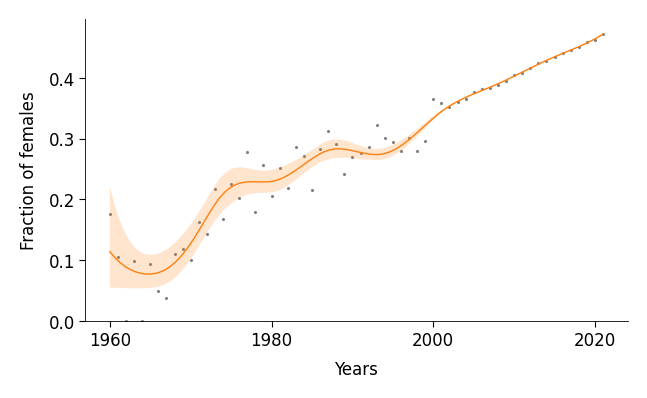

In [28]:
%matplotlib inline

years = np.unique(X_years)

with plt.style.context('matplotlib_style.txt'):
    fig, ax = plt.subplots(figsize=(3.5, 2), dpi=200)
    
    ax.scatter(np.unique(X_years), average_fraction_female, 
             c='grey', marker='.', s=5, lw=0)
    
    ax.plot(XX[:, 0], pdep, c='tab:orange')
    
    ax.fill_between(XX[:, 0], confi[:,1], confi[:,0], 
                    color='tab:orange', alpha=0.2, edgecolor=None)

    ax.set_ylim(bottom=0)

    ax.set_xlabel('Years')
    ax.set_ylabel('Fraction of females')

    fig.savefig(figures_path / 'gam_fraction_female_first_author_1960.png')

## For different labels (first author)

### Import

In [13]:
#save results
colors_new = np.load(variables_path / "colors_new.npy", allow_pickle = True)

In [14]:
pickle_in = open(variables_path / "colors_new_legend.pkl","rb")
colors_new_legend = pickle.load(pickle_in)

### Calculation

In [19]:
%%time
labels = ['nursing', 'education', 'gynecology', 'nutrition', 'veterinary', 'optics', 'physics', 'computation',
'surgery', 'engineering', 'material', 'neuroscience', 'psychology', 'psychiatry', 'bioinformatics',
         'healthcare']
    
years = np.unique(year_first_author)
years = years[(years >= 1960) & (years <= 2021)]

X_years_labels = {}
y_genders_labels = {}
average_fraction_female_labels = {}
average_number_female_labels = {}

for label in labels:
    print(label)
    
    genders_label = gender_first_author[colors_new == colors_new_legend[label]]
    years_label = year_first_author[colors_new == colors_new_legend[label]]


    X_years, y_genders, average_fraction_female, average_number_female = get_females_per_year(genders_label, 
                                                                                                years_label, 
                                                                                                years)
    X_years_labels[label] = X_years
    y_genders_labels[label] = y_genders
    average_fraction_female_labels[label] = average_fraction_female
    average_number_female_labels[label] = average_number_female


nursing
education
gynecology
nutrition
veterinary
optics
physics
computation
surgery
engineering
material
neuroscience
psychology
psychiatry
bioinformatics
healthcare
CPU times: user 9.73 s, sys: 0 ns, total: 9.73 s
Wall time: 9.73 s


In [20]:
f = open(variables_path / "X_years_fraction_female_labels.pkl","wb")
pickle.dump(X_years_labels,f)
f.close()

f = open(variables_path / "average_fraction_female_labels.pkl","wb")
pickle.dump(average_fraction_female_labels,f)
f.close()

### Fitting a Generalized Additive Model (GAM)

In [21]:
%%time

gam_plotting_results = pd.DataFrame(index = ['XX', 'pdep', 'confi', 'intercept'])

for label in labels:
    print(label)
    
    X_years = X_years_labels[label]
    y_genders = y_genders_labels[label]
    
    gam = train_logistic_gam(X_years, y_genders, verbose=True)
    
    XX, pdep, confi, intercept = get_plot_gam(gam, 'logistic')
    
    gam_plotting_results[label] = [XX, pdep, confi, intercept]
    

nursing


100% (20 of 20) |########################| Elapsed Time: 0:00:06 Time:  0:00:06
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:310: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      5.6136
Link Function:                        LogitLink Log Likelihood:                                -39294.5359
Number of Samples:                        79477 AIC:                                            78600.2989
                                                AICc:                                           78600.3002
                                                UBRE:                                                2.989
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0009
Feature Function                  Lam

  0% (0 of 20) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/gpfs01/berens/user/rgonzalesmarquez/.local/lib/python3.8/site-packages/pygam/links.py:149: RuntimeWarning: divide by zero encountered in divide
  return dist.levels/(mu*(dist.levels - mu))
/gpfs01/berens/user/rgonzalesmarquez/.local/lib/python3.8/site-packages/pygam/pygam.py:591: RuntimeWarning: invalid value encountered in multiply
  return sp.sparse.diags((self.link.gradient(mu, self.distribution)**2 *
  5% (1 of 20) |#                        | Elapsed Time: 0:00:00 ETA:   0:00:08/gpfs01/berens/user/rgonzalesmarquez/.local/lib/python3.8/site-packages/pygam/links.py:149: RuntimeWarning: divide by zero encountered in divide
  return dist.levels/(mu*(dist.levels - mu))
/gpfs01/berens/user/rgonzalesmarquez/.local/lib/python3.8/site-packages/pygam/pygam.py:591: RuntimeWarning: invalid value encountered in multiply
  return sp.sparse.diags((self.link.gradient(mu, self.distribution)**2 *
 10% (2 of 20) |##      

LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                       7.588
Link Function:                        LogitLink Log Likelihood:                                -25033.3084
Number of Samples:                        37021 AIC:                                            50081.7928
                                                AICc:                                           50081.7973
                                                UBRE:                                                3.353
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0026
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:02 Time:  0:00:02
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:310: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      2.0975
Link Function:                        LogitLink Log Likelihood:                                -15402.4413
Number of Samples:                        22601 AIC:                                            30809.0776
                                                AICc:                                           30809.0787
                                                UBRE:                                               3.3632
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0126
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:05 Time:  0:00:05
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:310: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      8.1198
Link Function:                        LogitLink Log Likelihood:                                -36548.4659
Number of Samples:                        54216 AIC:                                            73113.1716
                                                AICc:                                            73113.175
                                                UBRE:                                               3.3487
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0072
Feature Function                  Lam

  0% (0 of 20) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/gpfs01/berens/user/rgonzalesmarquez/.local/lib/python3.8/site-packages/pygam/links.py:149: RuntimeWarning: divide by zero encountered in divide
  return dist.levels/(mu*(dist.levels - mu))
/gpfs01/berens/user/rgonzalesmarquez/.local/lib/python3.8/site-packages/pygam/pygam.py:591: RuntimeWarning: invalid value encountered in multiply
  return sp.sparse.diags((self.link.gradient(mu, self.distribution)**2 *
  5% (1 of 20) |#                        | Elapsed Time: 0:00:00 ETA:   0:00:07/gpfs01/berens/user/rgonzalesmarquez/.local/lib/python3.8/site-packages/pygam/links.py:149: RuntimeWarning: divide by zero encountered in divide
  return dist.levels/(mu*(dist.levels - mu))
/gpfs01/berens/user/rgonzalesmarquez/.local/lib/python3.8/site-packages/pygam/pygam.py:591: RuntimeWarning: invalid value encountered in multiply
  return sp.sparse.diags((self.link.gradient(mu, self.distribution)**2 *
 10% (2 of 20) |##      

LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      7.7946
Link Function:                        LogitLink Log Likelihood:                                -26690.6919
Number of Samples:                        38852 AIC:                                            53396.9732
                                                AICc:                                           53396.9776
                                                UBRE:                                               3.3745
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0075
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:03 Time:  0:00:03
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:310: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                       8.983
Link Function:                        LogitLink Log Likelihood:                                -19989.4669
Number of Samples:                        39397 AIC:                                            39996.8997
                                                AICc:                                           39996.9052
                                                UBRE:                                               3.0154
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0045
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:05 Time:  0:00:05
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:310: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()
  0% (0 of 20) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--

LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      8.1719
Link Function:                        LogitLink Log Likelihood:                                -38340.5705
Number of Samples:                        68825 AIC:                                            76697.4847
                                                AICc:                                           76697.4874
                                                UBRE:                                               3.1145
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0054
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:01 Time:  0:00:01
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:310: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      2.0087
Link Function:                        LogitLink Log Likelihood:                                 -9907.6194
Number of Samples:                        18032 AIC:                                            19819.2563
                                                AICc:                                           19819.2576
                                                UBRE:                                               3.0992
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0053
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:15 Time:  0:00:15
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:310: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      2.0733
Link Function:                        LogitLink Log Likelihood:                                -99857.7854
Number of Samples:                       181342 AIC:                                           199719.7174
                                                AICc:                                          199719.7175
                                                UBRE:                                               3.1014
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                    0.009
Feature Function                  Lam

  0% (0 of 20) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--/gpfs01/berens/user/rgonzalesmarquez/.local/lib/python3.8/site-packages/pygam/pygam.py:591: RuntimeWarning: overflow encountered in square
  return sp.sparse.diags((self.link.gradient(mu, self.distribution)**2 *
  5% (1 of 20) |#                        | Elapsed Time: 0:00:00 ETA:   0:00:06/gpfs01/berens/user/rgonzalesmarquez/.local/lib/python3.8/site-packages/pygam/pygam.py:591: RuntimeWarning: overflow encountered in square
  return sp.sparse.diags((self.link.gradient(mu, self.distribution)**2 *
100% (20 of 20) |########################| Elapsed Time: 0:00:04 Time:  0:00:04
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:310: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summa

LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      3.5079
Link Function:                        LogitLink Log Likelihood:                                -26824.8453
Number of Samples:                        43573 AIC:                                            53656.7064
                                                AICc:                                           53656.7075
                                                UBRE:                                               3.2315
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0059
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:03 Time:  0:00:03
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:310: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      2.7425
Link Function:                        LogitLink Log Likelihood:                                -28661.2015
Number of Samples:                        43636 AIC:                                            57327.8882
                                                AICc:                                            57327.889
                                                UBRE:                                               3.3138
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0006
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:07 Time:  0:00:07
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:310: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      4.7975
Link Function:                        LogitLink Log Likelihood:                                 -54666.525
Number of Samples:                        80380 AIC:                                            109342.645
                                                AICc:                                           109342.646
                                                UBRE:                                               3.3604
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                    0.005
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:05 Time:  0:00:05
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:310: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      3.3502
Link Function:                        LogitLink Log Likelihood:                                -44761.6881
Number of Samples:                        65316 AIC:                                            89530.0766
                                                AICc:                                           89530.0773
                                                UBRE:                                               3.3708
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0086
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:05 Time:  0:00:05
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:310: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()
  5% (1 of 20) |#                        | Elapsed Time: 0:00:00 ETA:  00:00:00

LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      3.9365
Link Function:                        LogitLink Log Likelihood:                                -43152.6109
Number of Samples:                        63288 AIC:                                            86313.0949
                                                AICc:                                           86313.0959
                                                UBRE:                                               3.3639
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0138
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:01 Time:  0:00:01
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:310: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()
 10% (2 of 20) |##                       | Elapsed Time: 0:00:00 ETA:   0:00:01

LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      4.1232
Link Function:                        LogitLink Log Likelihood:                                 -7689.0355
Number of Samples:                        13853 AIC:                                            15386.3175
                                                AICc:                                            15386.322
                                                UBRE:                                               3.1109
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                    0.004
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:00 Time:  0:00:00


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      5.2523
Link Function:                        LogitLink Log Likelihood:                                 -8558.0253
Number of Samples:                        12382 AIC:                                            17126.5552
                                                AICc:                                           17126.5625
                                                UBRE:                                               3.3835
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0028
Feature Function                  Lam

/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:310: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


In [22]:
# save
gam_plotting_results.to_pickle(variables_path / "gam_fraction_female_labels_plotting_results")

### Plot

In [16]:
pickle_in = open(variables_path / "X_years_fraction_female_labels.pkl","rb")
X_years_labels = pickle.load(pickle_in)

pickle_in = open(variables_path / "average_fraction_female_labels.pkl","rb")
average_fraction_female_labels = pickle.load(pickle_in)

In [6]:
# load 
gam_plotting_results=pd.read_pickle(variables_path / "gam_fraction_female_labels_plotting_results")

In [7]:
gam_plotting_results_T=gam_plotting_results.transpose()

In [8]:
labels = ['nursing', 'education', 'gynecology', 'nutrition', 'veterinary', 'optics', 'physics', 'computation',
'surgery', 'engineering', 'material', 'neuroscience', 'psychology', 'psychiatry', 'bioinformatics', 
         'healthcare']

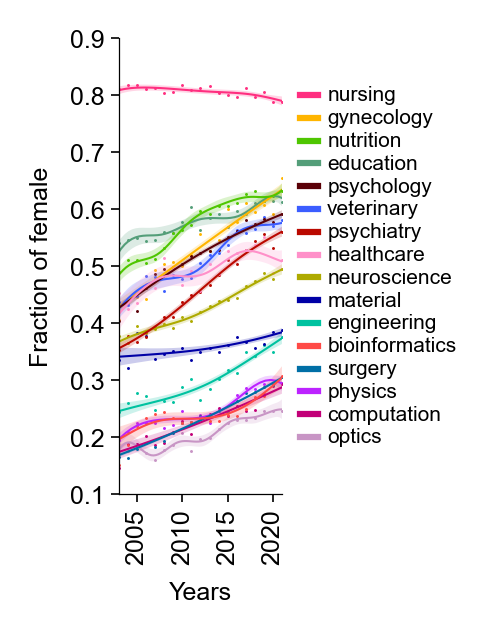

In [18]:
%matplotlib inline 

last_point_labels=[]

with plt.style.context('matplotlib_style.txt'):
    fig, ax = plt.subplots(figsize=(1.5, 2), dpi=300, layout='constrained')
    
    for label in labels:
        #print(label)

        ax.plot(gam_plotting_results_T.XX[label][:, 0], (gam_plotting_results_T.pdep[label]),
            c=colors_new_legend[label])

        ax.fill_between(gam_plotting_results_T.XX[label][:, 0], 
                        (gam_plotting_results_T.confi[label])[:,1], 
                        (gam_plotting_results_T.confi[label])[:,0], 
                        color=colors_new_legend[label], alpha=0.2, edgecolor=None)

        ax.scatter(np.unique(X_years_labels[label]), average_fraction_female_labels[label], 
                   c=colors_new_legend[label], marker='.', s=2, lw=0)
        
        last_point_labels.append(average_fraction_female_labels[label][-1])
        
    last_point_labels = np.hstack(last_point_labels)
    
    # plot handmade legend
    sorted_indeces = np.flip(np.argsort(last_point_labels))
    sorted_labels = np.array(labels)[sorted_indeces]

    x=2026*np.ones(len(sorted_labels))
    y=np.linspace(0.8,0.2,len(sorted_labels))
    
    for i, label in enumerate(sorted_labels):
        colr = colors_new_legend[label]
        ax.plot([2023, 2025], [y[i],y[i]], '-', ms=3, linewidth=1.5, c=colr, clip_on=False)
        ax.text(x[i], y[i], label, fontsize=5, va='center')
        
        
    ax.set_ylabel('Fraction of female')
    ax.set_xlabel('Years')
    ax.set_xticks([2005, 2010, 2015, 2020], labels=[2005, 2010, 2015, 2020], fontsize=6)
    ax.set_xlim(left = 2003, right=2021)
    ax.set_ylim(0.1, 0.9)
    plt.setp([tick.label1 for tick in ax.xaxis.get_major_ticks()], rotation=90,
         ha="right", va="center", rotation_mode="anchor")


    #save
    fig.savefig(figures_path / "gam_fraction_female_per_years_per_label_first_author_with_healthcare_ethics.png", facecolor = 'white')

## Last author

### Import

In [29]:
# import clean_df_updated
year_name_gender_last_author_df=pd.read_pickle(variables_path / "year_name_gender_last_author_df")

In [30]:
gender_last_author = year_name_gender_last_author_df.Gender.to_numpy()
year_last_author = year_name_gender_last_author_df.Years.to_numpy()

### Calculation

In [31]:
%%time
years = np.unique(year_last_author)
years = years[(years >= 1960) & (years <= 2021)]

X_years, y_genders, average_fraction_female, average_number_female = get_females_per_year(gender_last_author, 
                                                                                            year_last_author, 
                                                                                            years)

CPU times: user 4.73 s, sys: 3.64 ms, total: 4.73 s
Wall time: 4.74 s


In [32]:
np.save(variables_path / 'X_years_last_author', X_years)
np.save(variables_path / 'y_genders_last_author', y_genders)
np.save(variables_path / 'average_fraction_female_last_author', average_fraction_female)
np.save(variables_path / 'average_number_female_last_author', average_number_female)

In [25]:
X_years = np.load(variables_path / 'X_years_last_author.npy')
y_genders = np.load(variables_path / 'y_genders_last_author.npy')
average_fraction_female = np.load(variables_path / 'average_fraction_female_last_author.npy')
average_number_female = np.load(variables_path / 'average_number_female_last_author.npy')

In [35]:
print(y_genders.shape)
print(X_years.shape)
print(average_fraction_female.shape)
print(average_number_female.shape)

(8460032,)
(8460032,)
(62,)
(62,)


### Fitting a Generalized Additive Model (GAM)

In [37]:
%%time

n_features = 1 # number of features used in the model

lams = np.logspace(-5,5,20) * n_features 
splines = 12 # number of splines we will use

# linear GAM for Regression
gam = LogisticGAM(s(0, n_splines=12)).fit(X_years, y_genders)

gam.gridsearch(X_train, y_train, lam=lams)
    
gam.summary()

100% (20 of 20) |########################| Elapsed Time: 0:10:56 Time:  0:10:56


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                     10.8432
Link Function:                        LogitLink Log Likelihood:                              -4063330.6498
Number of Samples:                      6768025 AIC:                                          8126682.9861
                                                AICc:                                         8126682.9861
                                                UBRE:                                               3.2007
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0043
Feature Function                  Lam

<timed exec>:11: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 



In [38]:
%%time
XX, pdep, confi, intercept = get_plot_gam(gam, 'logistic')

CPU times: user 3.96 ms, sys: 934 µs, total: 4.89 ms
Wall time: 3.64 ms


In [39]:
np.save(variables_path / 'XX_gam_fraction_female_last_author_1960', XX)
np.save(variables_path / 'pdep_gam_fraction_female_last_author_1960', pdep)
np.save(variables_path / 'confi_gam_fraction_female_last_author_1960', confi)
np.save(variables_path / 'intercept_gam_fraction_female_last_author_1960', intercept)

### Plot

In [40]:
XX_last = np.load(variables_path / 'XX_gam_fraction_female_last_author_1960.npy')
pdep_last = np.load(variables_path / 'pdep_gam_fraction_female_last_author_1960.npy')
confi_last = np.load(variables_path / 'confi_gam_fraction_female_last_author_1960.npy')
intercept_last = np.load(variables_path / 'intercept_gam_fraction_female_last_author_1960.npy')

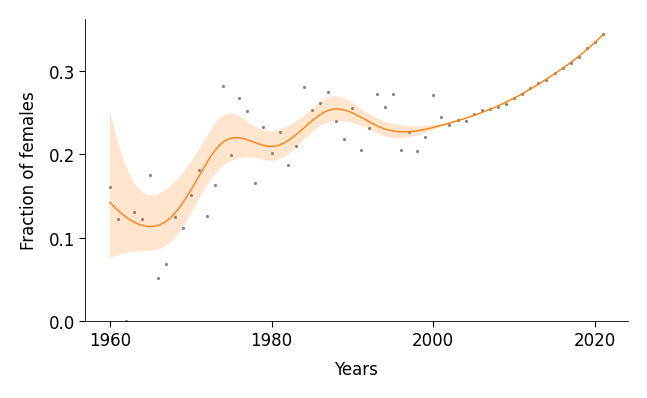

In [42]:
%matplotlib inline

years = np.unique(X_years)

with plt.style.context('matplotlib_style.txt'):
    fig, ax = plt.subplots(figsize=(3.5, 2), dpi=200)
    
    ax.scatter(np.unique(X_years), average_fraction_female, 
             c='grey', marker='.', s=5, lw=0)
    
    ax.plot(XX[:, 0], pdep, c='tab:orange')
    
    ax.fill_between(XX[:, 0], confi[:,1], confi[:,0], 
                    color='tab:orange', alpha=0.2, edgecolor=None)

    ax.set_ylim(bottom=0)

    ax.set_xlabel('Years')
    ax.set_ylabel('Fraction of females')

    fig.savefig(figures_path / 'gam_fraction_female_last_author_1960.png')

## Plot for first and last author

In [43]:
XX_first = np.load(variables_path / 'XX_gam_fraction_female_first_author_1960.npy')
pdep_first = np.load(variables_path / 'pdep_gam_fraction_female_first_author_1960.npy')
confi_first = np.load(variables_path / 'confi_gam_fraction_female_first_author_1960.npy')
intercept_first = np.load(variables_path / 'intercept_gam_fraction_female_first_author_1960.npy')

In [44]:
XX_last = np.load(variables_path / 'XX_gam_fraction_female_last_author_1960.npy')
pdep_last = np.load(variables_path / 'pdep_gam_fraction_female_last_author_1960.npy')
confi_last = np.load(variables_path / 'confi_gam_fraction_female_last_author_1960.npy')
intercept_last = np.load(variables_path / 'intercept_gam_fraction_female_last_author_1960.npy')

In [45]:
average_fraction_female_first_author = np.load(variables_path / 'average_fraction_female_first_author.npy')
average_fraction_female_last_author = np.load(variables_path / 'average_fraction_female_last_author.npy')

X_years_first_author = np.load(variables_path / 'X_years_first_author.npy')
X_years_last_author = np.load(variables_path / 'X_years_last_author.npy')

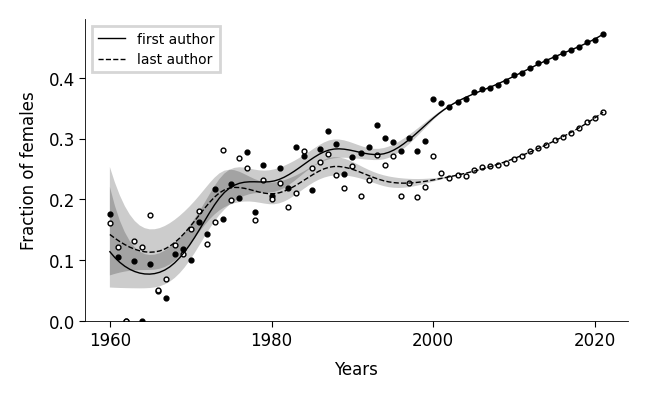

In [46]:
%matplotlib inline

with plt.style.context('matplotlib_style.txt'):
    fig, ax = plt.subplots(figsize=(3.5, 2), dpi=200)

    ax.plot(XX_first[:, 0], pdep_first, color='k', linestyle='-', label = 'first author')
    
    ax.fill_between(XX_first[:, 0], confi_first[:,1], confi_first[:,0], 
                    color='k', alpha=0.2, edgecolor=None)
    ax.scatter(np.unique(X_years_first_author), average_fraction_female_first_author, 
             c='k', marker='o', s=3, edgecolor='k', linewidth=0.5)
    
    
    ax.plot(XX_last[:, 0], pdep_last,  color='k', linestyle='--', label = 'last author')
    
    ax.fill_between(XX_last[:, 0], confi_last[:,1], confi_last[:,0], 
                    color='k', alpha=0.2, edgecolor=None)
    
    ax.scatter(np.unique(X_years_last_author), average_fraction_female_last_author, 
             c='white', marker='o', s=3, edgecolor='k', linewidth=0.5)

    ax.legend(loc='upper left',fontsize=5)
    ax.set_ylim(bottom=0)
    ax.set_xlabel('Years')
    ax.set_ylabel('Fraction of females')

    fig.savefig(figures_path / 'gam_fraction_female_1960_black.png', facecolor='white')